In [1]:
#############################################################################
# zlib License
#
# (C) 2023 Zach Flowers, Murtaza Safdari <musafdar@cern.ch>
#
# This software is provided 'as-is', without any express or implied
# warranty.  In no event will the authors be held liable for any damages
# arising from the use of this software.
#
# Permission is granted to anyone to use this software for any purpose,
# including commercial applications, and to alter it and redistribute it
# freely, subject to the following restrictions:
#
# 1. The origin of this software must not be misrepresented; you must not
#    claim that you wrote the original software. If you use this software
#    in a product, an acknowledgment in the product documentation would be
#    appreciated but is not required.
# 2. Altered source versions must be plainly marked as such, and must not be
#    misrepresented as being the original software.
# 3. This notice may not be removed or altered from any source distribution.
#############################################################################

# Imports

In [2]:
#%%
%matplotlib inline
import matplotlib.pyplot as plt
import logging
import i2c_gui
import i2c_gui.chips
from i2c_gui.usb_iss_helper import USB_ISS_Helper
from i2c_gui.fpga_eth_helper import FPGA_ETH_Helper
import numpy as np
from mpl_toolkits.axes_grid1 import make_axes_locatable
# import time
from tqdm import tqdm
# from i2c_gui.chips.etroc2_chip import register_decoding
import os, sys
import multiprocessing
os.chdir(f'/home/{os.getlogin()}/ETROC2/ETROC_DAQ')
import run_script
import parser_arguments
import importlib
importlib.reload(run_script)
import datetime
import pandas as pd
from pathlib import Path
import subprocess
import sqlite3
from notebooks.notebook_helpers import *
from fnmatch import fnmatch
import scipy.stats as stats
from math import ceil
from numpy import savetxt
from scripts.log_action import log_action_v2
from time import sleep
from matplotlib.dates import DateFormatter

# Set defaults

In [19]:
# !!!!!!!!!!!!
# It is very important to correctly set the chip name, this value is stored with the data
chip_names = ["ET2_EPIR_Pair1", "ET2p01_BAR_4", "ET2p01_BAR_6", "ET2_EPIR_Pair4"]
chip_fignames = ["ET2 EPIR Pair 1", "ET2.01 Barcelona 4", "ET2.01 Barcelona 6", "ET2 EPIR Pair4"]
chip_names = ["ET2_EPIR_Pair1", "ET2p01_BAR_4", "ET2p01_BAR_5", "ET2_EPIR_Pair4"]
chip_fignames = ["ET2 EPIR Pair 1", "ET2.01 Barcelona 4", "ET2.01 Barcelona 5", "ET2 EPIR Pair4"]
# chip_names = ["ET2_EPIR_Pair4"]
# chip_fignames = ["ET2 EPIR Pair4"]
# chip_names = ["ET2_BAR_11"]
# chip_fignames = ["ET2 BAR 11"]
chip_figtitles = chip_names

# 'The port name the USB-ISS module is connected to. Default: /dev/ttyACM0'
port = "/dev/ttyACM1"
# I2C addresses for the pixel block and WS
chip_addresses = [0x60, 0x61, 0x62, 0X63]
# chip_addresses = [0x63]
ws_addresses = [None, None, None, None]#, None, None]

fig_outdir = Path('../ETROC-figures')
fig_outdir = fig_outdir / (datetime.date.today().isoformat() + '_Array_Test_Results')
fig_outdir.mkdir(exist_ok=True)
fig_path = str(fig_outdir)

hostname = "192.168.2.3"
today = datetime.date.today().isoformat()
polarity = "0x0127" # 0x0023 or 0x0027
LED_page = "0x0000"
active_channel = "0x000f"
delay = "0x1800"
# "Run1"
# "PreBeam_BLmonitoring_nochiller_plastic"
# "PreBeam_BLmonitoring_withchiller12c"
# "PreBeam_BLmonitoring_withchiller12c_2"
# PreBeam_BLmonitoring_withchiller12c_ONR
# PreBeam_BLmonitoring_withchiller12c_30mins
# PreBeam_BLmonitoring_withchiller12c_30mins_bar5
note_for_df = 'PreBeam_BLmonitoring_withchiller12c_30mins_bar5'
interval_time = 5.*60.
global_time = 0.5* 60.* 60.

histdir = Path('/media/daq/X9/ETROC-History-DESY-Feb-2024/')
histdir.mkdir(exist_ok=True)
histfile = histdir / 'BaselineHistory_test.sqlite'

# Make i2c_connection class object

In [4]:
# i2c_conn = self, port, chip_addresses, chip_names, chip_fc_delays
i2c_conn = i2c_connection(port,chip_addresses,ws_addresses,chip_names,[("1","1"),("1","1"),("1","1"), ("1","1")])

# Config chips

### Key is (Disable Pixels, Auto Cal, Chip Peripherals, Basic Peri Reg Check, Pixel Check)

In [5]:
# (WS Prep Pixel and Peri) - 0 - (disable & auto_cal all pixels) - (disable default all pixels) - (auto_TH_CAL) - (set basic peripherals) - (peripheral reg check) -  (pixel ID check)
i2c_conn.config_chips('00100101')   # leaves the DAC at 1023
# i2c_conn.config_chips('01100101')   # leave sthe DAC at BL + 10
# i2c_conn.config_chips('00001111') # disable and more fun things
# i2c_conn.config_chips('00000100') # set basic peripherals
# i2c_conn.config_chips('00010000') # calibrate only
# i2c_conn.config_chips('00000001') # pixel ID check (I2C check)
# i2c_conn.config_chips('10000000') # ws init
# i2c_conn.disable_all_pixels(chip_address=chip_addresses[1])

Passed pixel check for chip: 0x60
Peripherals set for chip: 0x60
Disabled pixels for chip: 0x60
Disabled pixels (no change in DAC) for chip: 0x60


Calibrating row: 100%|██████████| 16/16 [01:31<00:00,  5.69s/it]


Auto calibration finished for chip: 0x60
Passed pixel check for chip: 0x61
Peripherals set for chip: 0x61
Disabled pixels for chip: 0x61
Disabled pixels (no change in DAC) for chip: 0x61


Calibrating row: 100%|██████████| 16/16 [01:30<00:00,  5.68s/it]


Auto calibration finished for chip: 0x61
Passed pixel check for chip: 0x62
Peripherals set for chip: 0x62
Disabled pixels for chip: 0x62
Disabled pixels (no change in DAC) for chip: 0x62


Calibrating row: 100%|██████████| 16/16 [01:30<00:00,  5.67s/it]


Auto calibration finished for chip: 0x62
Passed pixel check for chip: 0x63
Peripherals set for chip: 0x63
Disabled pixels for chip: 0x63
Disabled pixels (no change in DAC) for chip: 0x63


Calibrating row: 100%|██████████| 16/16 [01:30<00:00,  5.67s/it]

Auto calibration finished for chip: 0x63


## Visualize the learned Baselines (BL) and Noise Widths (NW)

Note that the NW represents the full width on either side of the BL

In [12]:
#%%
%matplotlib inline
import matplotlib.pyplot as plt
plt.figure()
plt.show()

<Figure size 1000x1000 with 0 Axes>

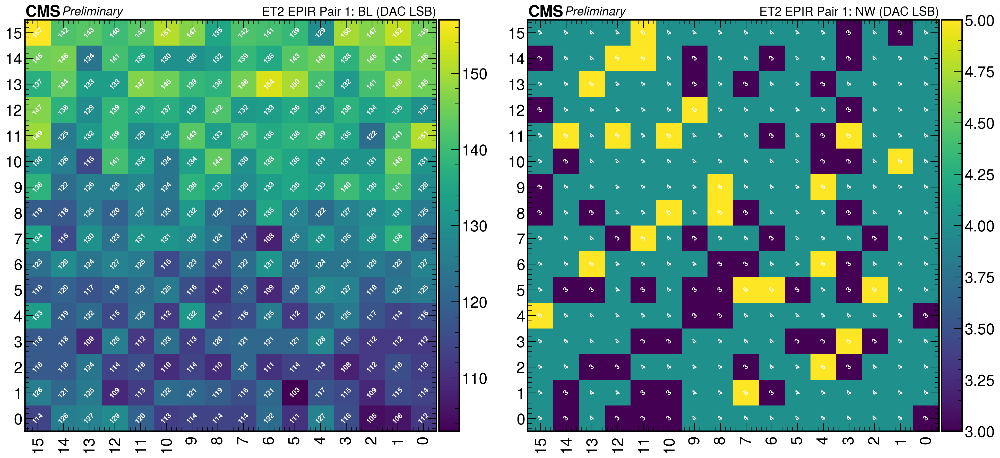

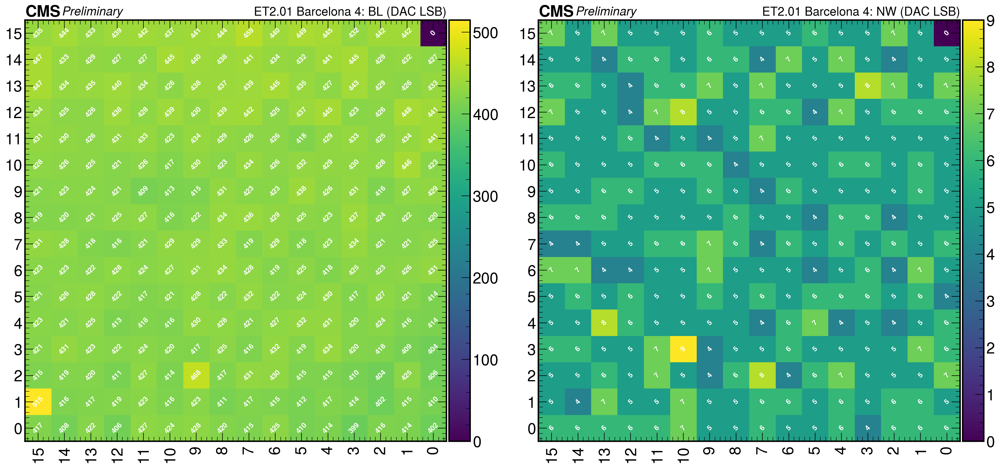

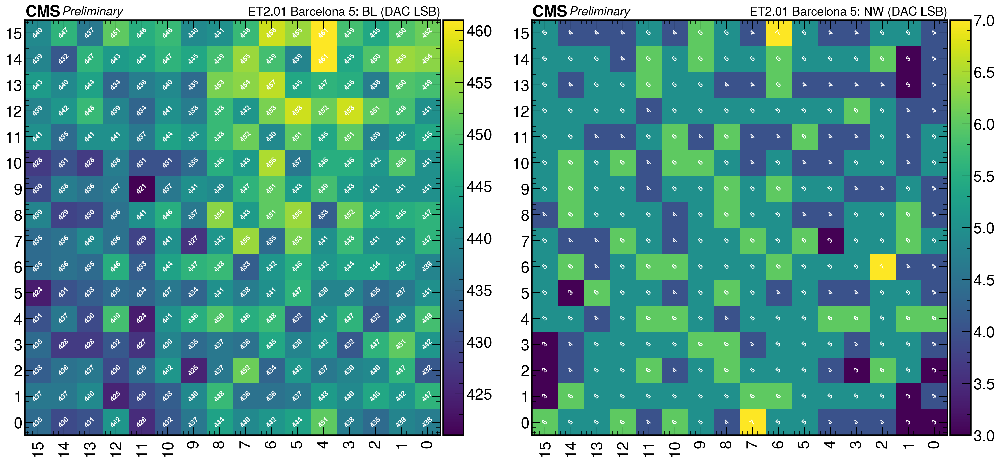

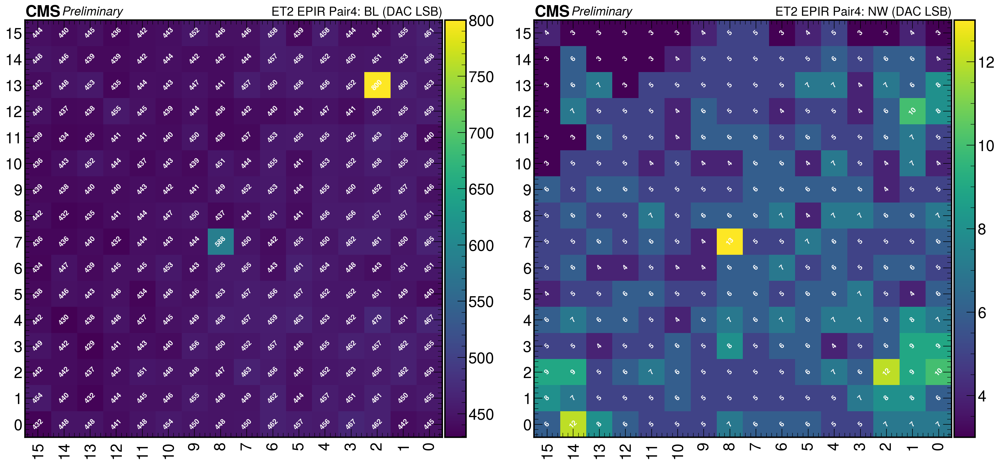

In [7]:
i2c_conn.save_baselines(chip_fignames,fig_path,histfile)

In [9]:
for chip_address, chip_name in zip(chip_addresses, chip_names):
    i2c_conn.save_auto_cal_BL_map(chip_address, chip_name, f"BL_NW_{chip_name}")
    i2c_conn.save_auto_cal_NW_map(chip_address, chip_name, f"BL_NW_{chip_name}")

In [12]:
for chip_address, chip_name in zip(chip_addresses, chip_names):
    i2c_conn.load_auto_cal_BL_map(chip_address, chip_name, f"BL_NW_{chip_name}")
    i2c_conn.load_auto_cal_NW_map(chip_address, chip_name, f"BL_NW_{chip_name}")

# Define pixels of interest

In [13]:
# row_list = [15, 15, 15, 15]
# col_list = [6, 7, 8, 9]
# row_list = [14, 14, 14, 14]
# col_list = [6, 7, 8, 9]
# row_list = [9, 3, 12]
# col_list = [3, 8, 11]
# row_list = [15, 15]
# col_list = [6, 9]
# row_list = [14, 2, 2, 14]
# col_list = [2, 14, 2, 14]
row_list = [14, 14, 14, 8, 8, 8, 2, 2, 2]
col_list = [14,  8,  2, 14,8, 2,14, 8, 2]
# row_list = [14, 14, 14, 14, 15, 15, 15, 15]
# col_list = [6, 7, 8, 9, 6, 7, 8, 9]
# col_list = np.arange(16)
# row_list = np.full_like(col_list,12)
# row_list = np.full_like(col_list,13)
# col_list = [10, 13, 7, 4, 10, 13, 7, 4]
# row_list = [12, 12, 12, 12, 13, 13, 13, 13]

scan_list = list(zip(row_list, col_list))

# col_list, row_list = np.meshgrid(np.arange(16),np.arange(16))
# scan_list = list(zip(row_list.flatten(),col_list.flatten()))

print(scan_list)

[(14, 14), (14, 8), (14, 2), (8, 14), (8, 8), (8, 2), (2, 14), (2, 8), (2, 2)]


# Automatic Logging

In [14]:
start_time = time.time()
while True:
# i=0
# while i<1:
    for chip_address, chip_name in zip(chip_addresses, chip_names):
        # start_time = time.time()
        data = []
        for row,col in scan_list:
            i2c_conn.auto_cal_pixel(chip_name,row,col,False,chip_address,None,data,None,None)
        BL_df = pd.DataFrame(data = data)
        BL_df['chip_name'] = chip_name
        BL_df['note'] = note_for_df
        with sqlite3.connect(histfile) as sqlconn:
            BL_df.to_sql('baselines', sqlconn, if_exists='append', index=False)
        del data
        # end_time = time.time()
        # print(f"This board took {end_time-start_time} s")
    end_time = time.time()
    if (end_time - start_time > global_time):
        print('Stopping because of time limit')
        break
    time.sleep(interval_time)
    # i += 1


Stopping because of time limit


## Plot auto logging

### func for plotting

In [16]:
def makePlot(var, inputname, scan_pixels, timestamp_cut=None, note_cut=None, label=None, df=None):
    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(24,9))
    ax.set_prop_cycle(color=['#e41a1c','#fdbf6f','#d95f02', '#377eb8','#4daf4a','#b2df8a',])

    i = 0

    threshold_timestamp = pd.Timestamp(timestamp_cut)
    for row, col in scan_pixels:
        filtered_df = df[(df['chip_name'] == inputname) & (df['row'] == row) & (df['col'] == col) & (df['baseline'] != 0)].copy()
        # filtered_df = df[(df['chip_name'] == inputname) & df.loc[row_indexer,col_indexer]  & (df['baseline'] != 0)]
        filtered_df['timestamp'] = pd.to_datetime(filtered_df['timestamp'])

        if note_cut is not None:
            filtered_df = filtered_df[filtered_df['note'].str.contains(note_cut)]
        if timestamp_cut is not None:
            filtered_df = filtered_df.loc[filtered_df['timestamp'] > threshold_timestamp]

        hep.cms.text(loc=0, ax=ax, text="Preliminary", fontsize=25)
        if label is not None:
            ax.set_title(label, size=17, loc="right")
        ax.plot(filtered_df['timestamp'], filtered_df[var], '.-', label=f'Row-Col = ({row}-{col})')

        # Set x-axis labels with line breaks using LaTeX notation
        if i == 0:
            date_form = DateFormatter("%Y-%m-%d %H:%M")
            ax.xaxis.set_major_formatter(date_form)
            plt.xticks(rotation=60)
            # x_labels = [f'{row["note"].replace(f"_{chip_name}","")}\n{row["timestamp"].strftime("%Y-%m-%d %H:%M")}' for index, row in filtered_df.iterrows()]
            # ax.set_xticks(filtered_df['timestamp'])
            # ax.set_xticklabels(x_labels, rotation=90, fontsize=9)

        i += 1

    ax.grid(which='both', axis='y')
    ax.xaxis.set_minor_locator(plt.NullLocator())
    ax.legend(ncols=2, fontsize=14)

    var_label = str(var).replace('_', ' ')

    # Set labels for other axes as needed
    ax.set_ylabel(f'{inputname} {var_label}')

### run plotting

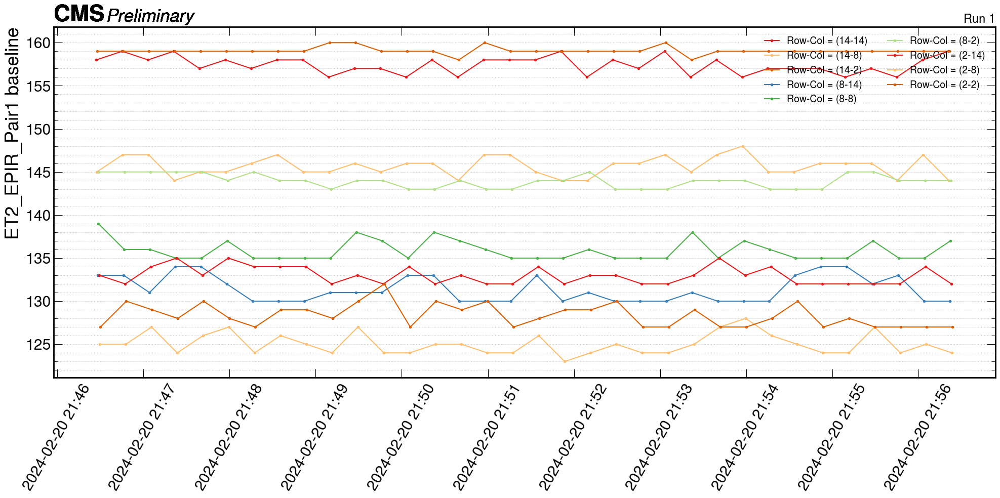

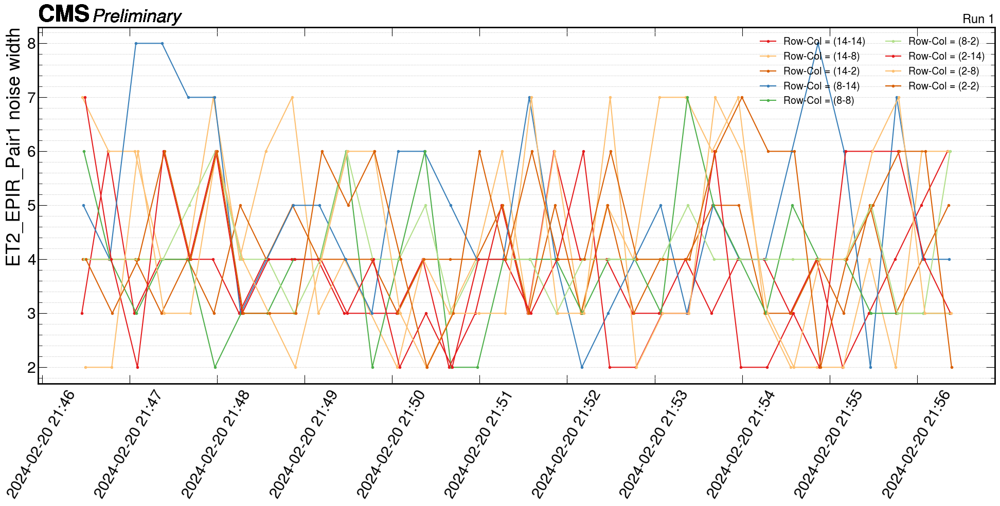

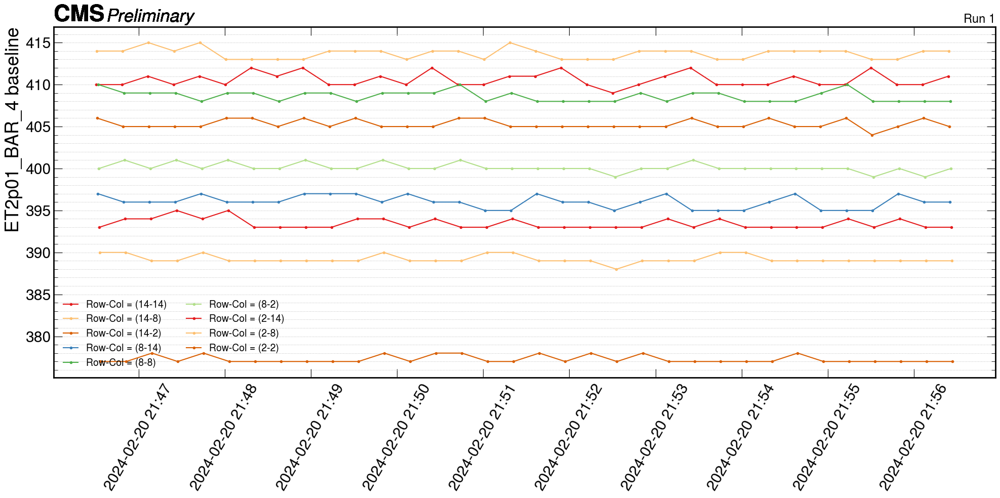

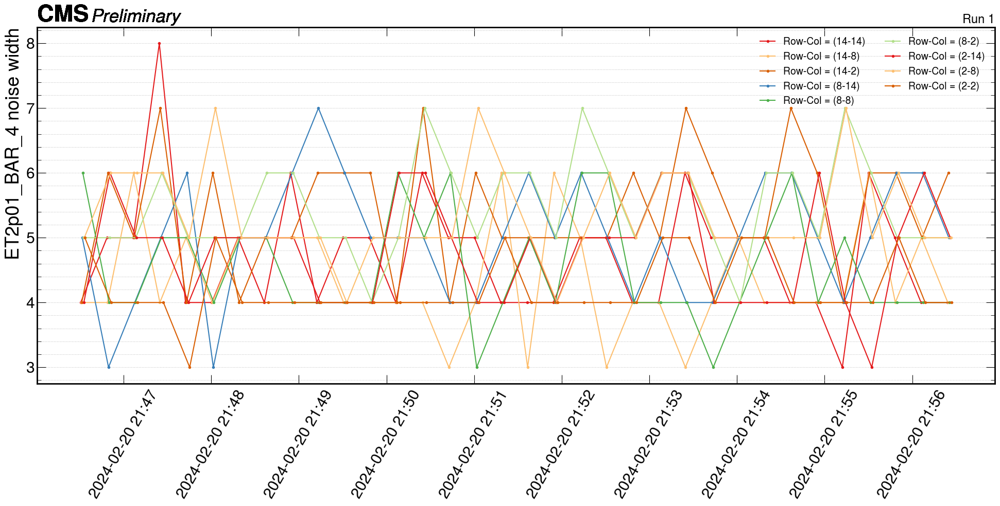

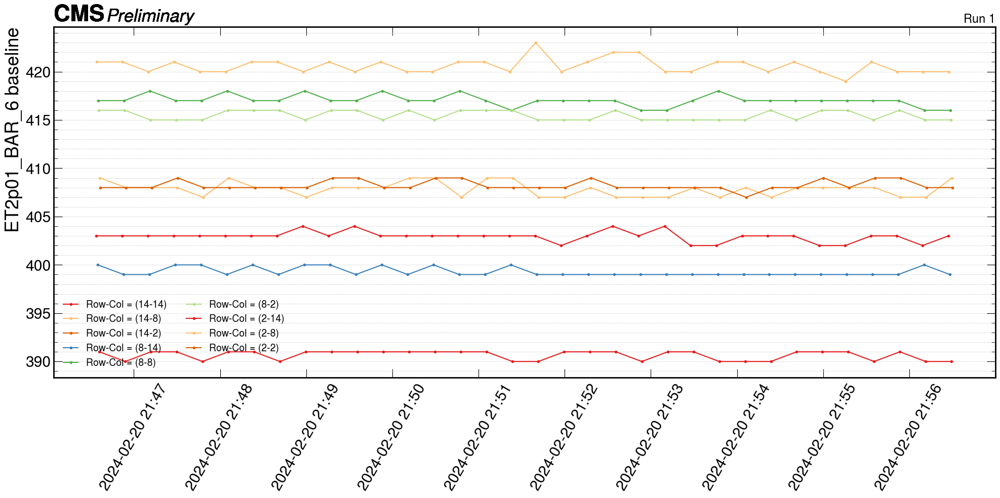

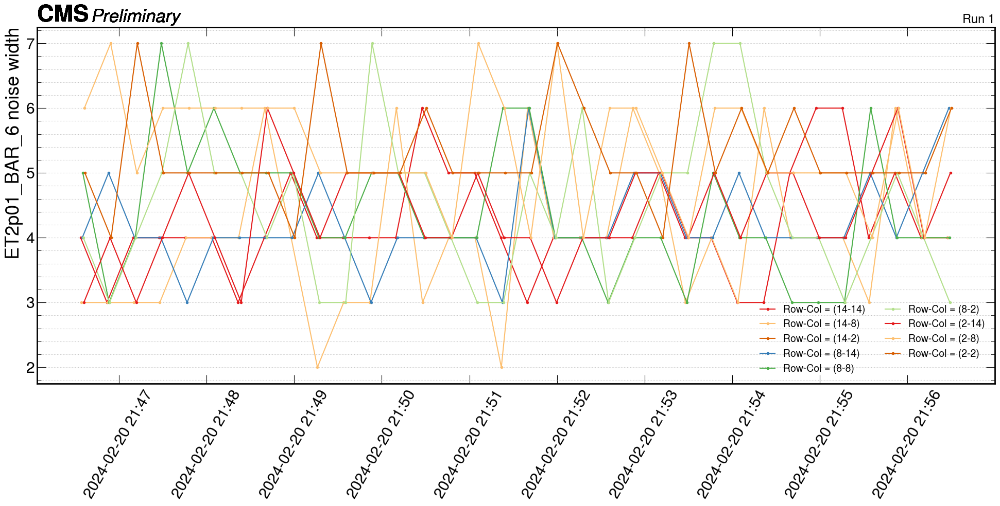

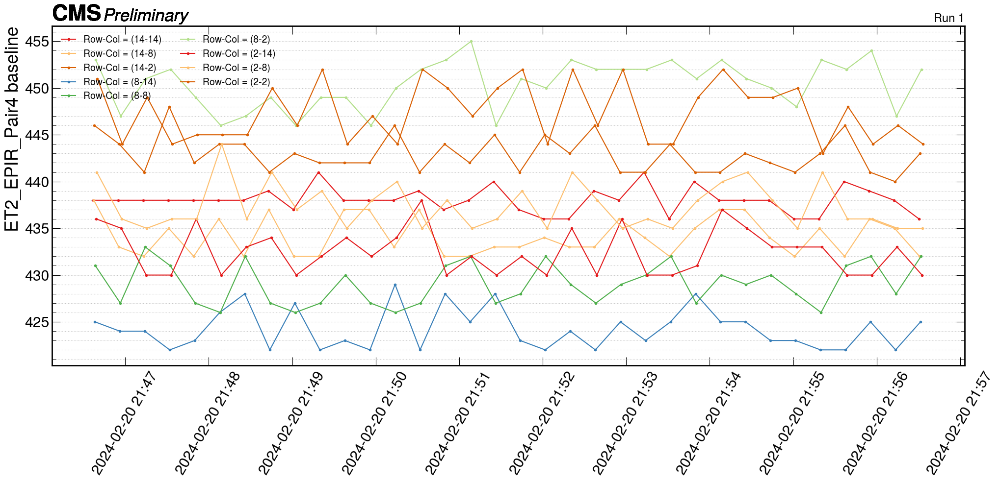

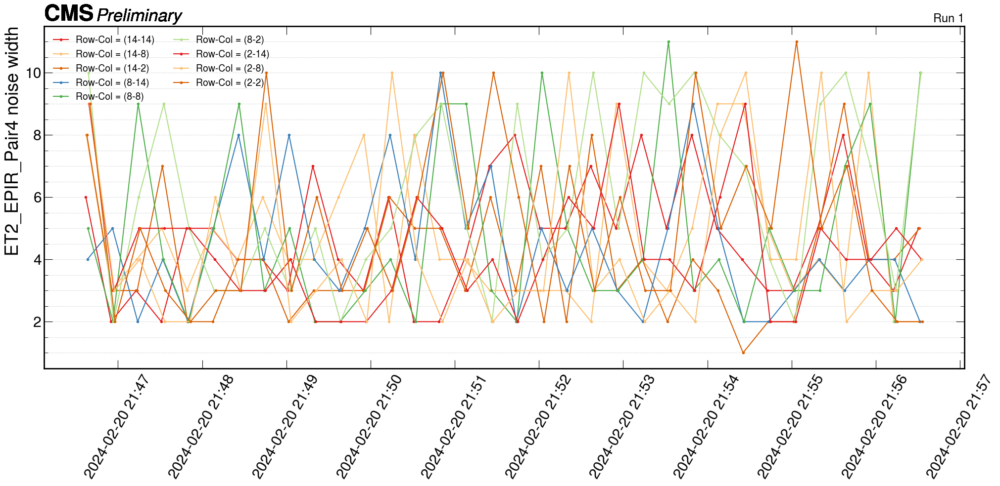

In [18]:
con = sqlite3.connect(histfile)
df = pd.read_sql_query("SELECT * from baselines", con)

time_cut = None
note_cut = None
label = 'Run 1' # Feb 20 test run in the open no chiller

for chip_name in chip_names:
    makePlot('baseline', chip_name, scan_list, time_cut, note_cut, label, df)
    makePlot('noise_width', chip_name, scan_list, time_cut, note_cut, label, df)

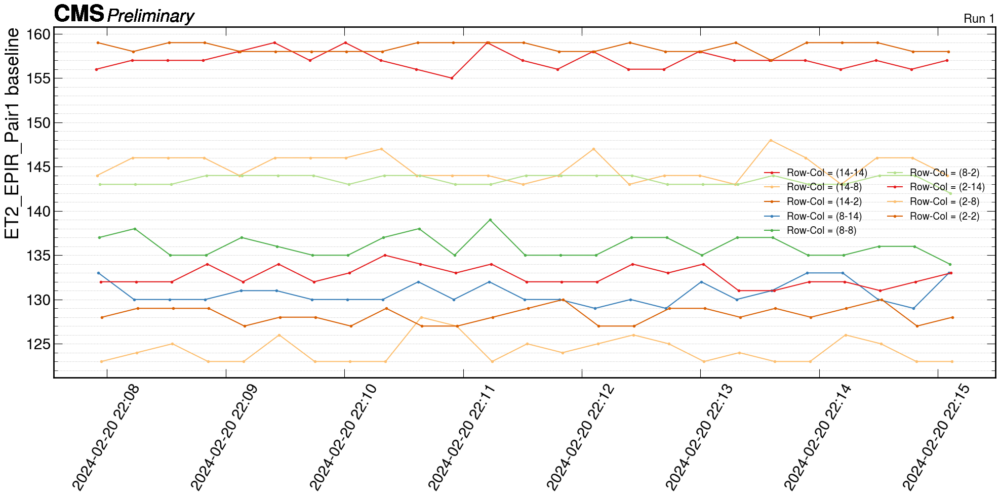

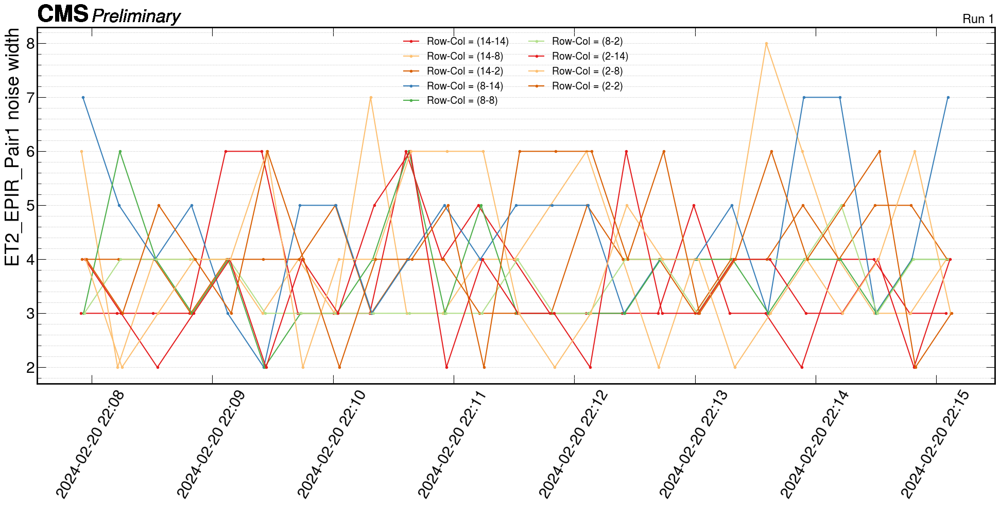

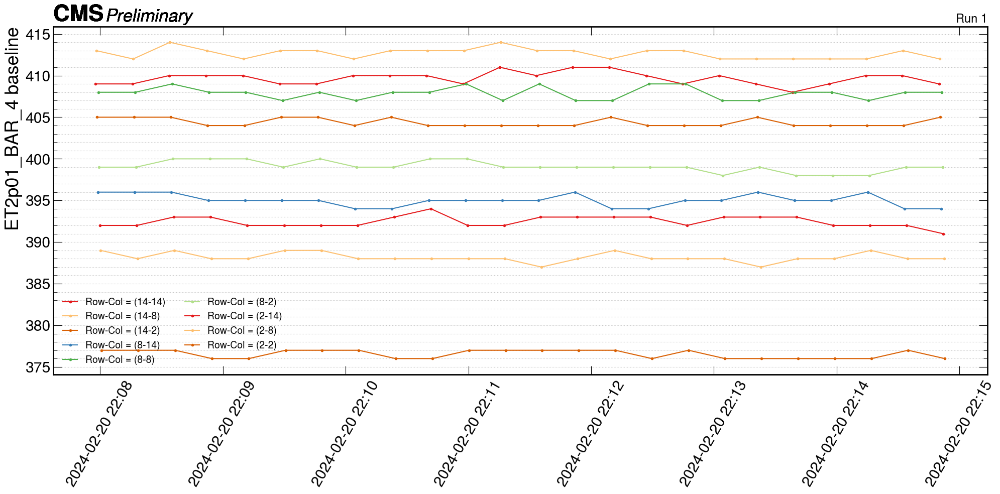

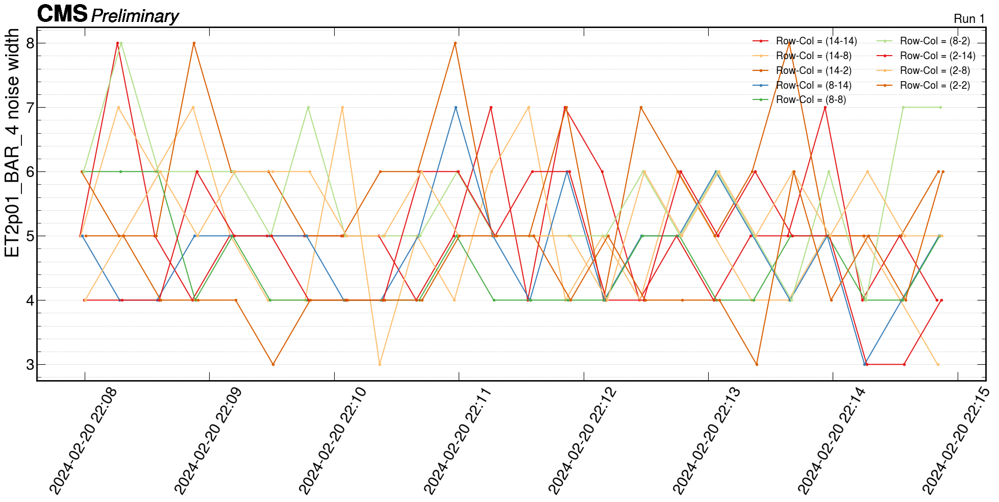

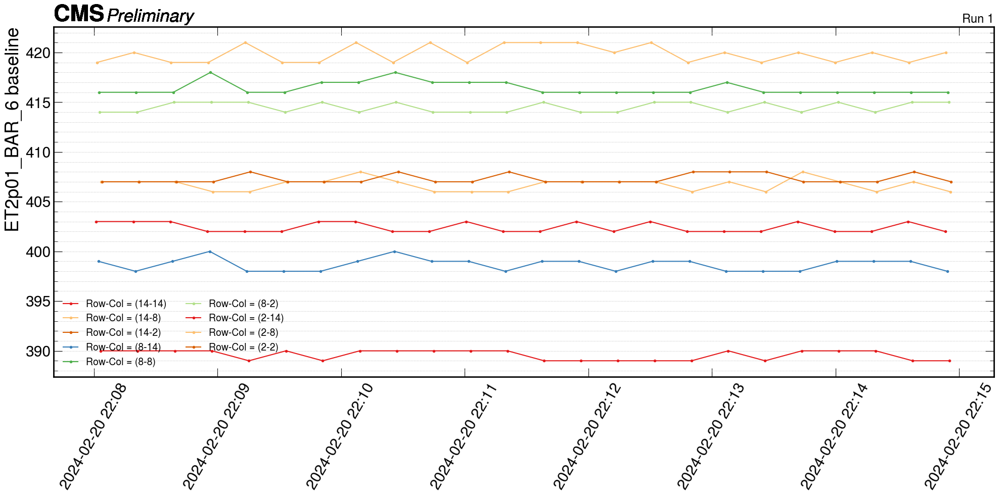

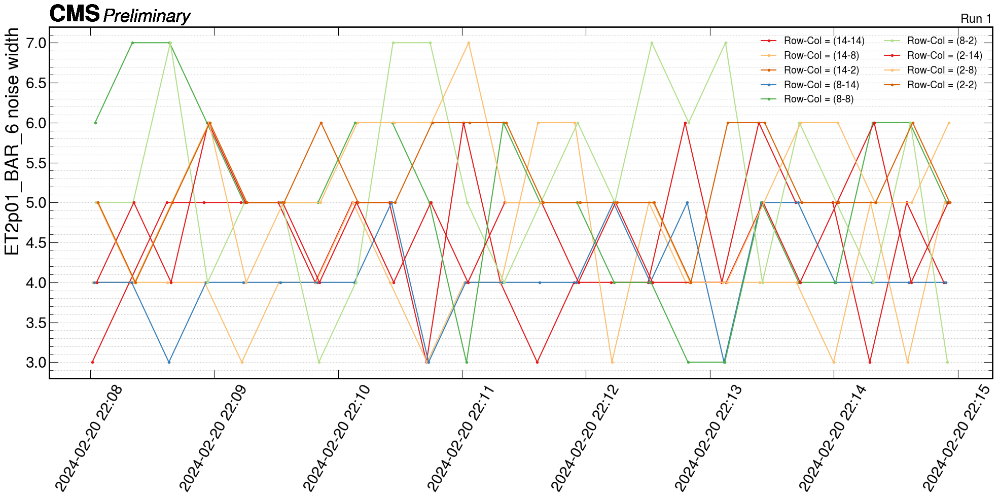

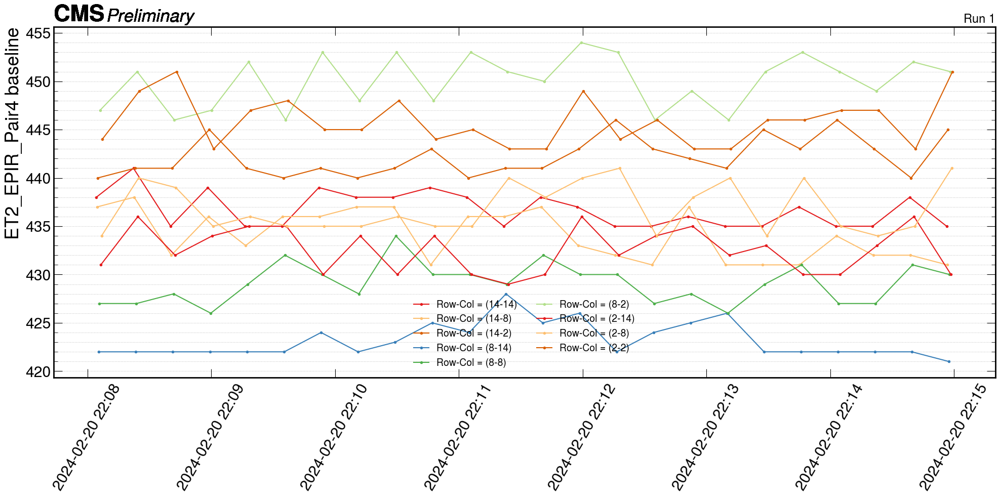

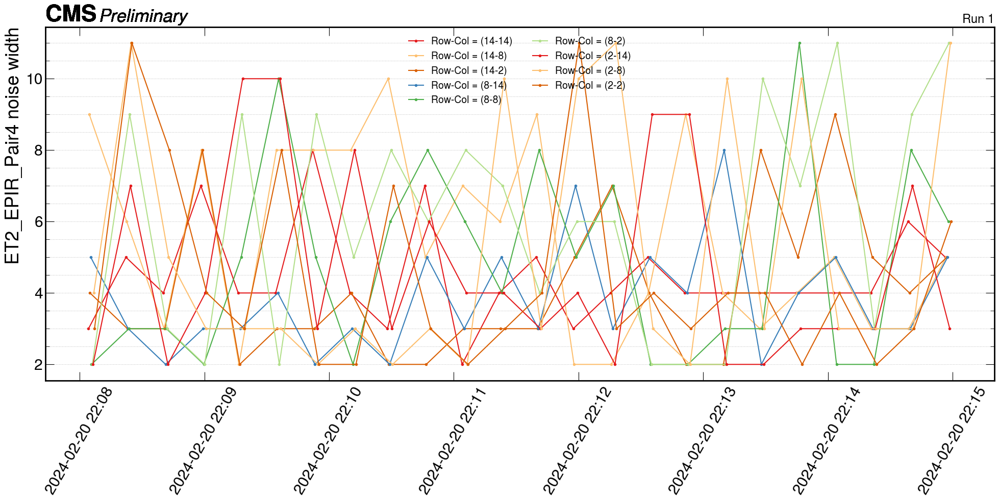

In [23]:
con = sqlite3.connect(histfile)
df = pd.read_sql_query("SELECT * from baselines", con)

time_cut = None
note_cut = "PreBeam_BLmonitoring_nochiller_plastic" # Feb 20 first run with black plastic no chiller
label = 'Run 1'

for chip_name in chip_names:
    makePlot('baseline', chip_name, scan_list, time_cut, note_cut, label, df)
    makePlot('noise_width', chip_name, scan_list, time_cut, note_cut, label, df)

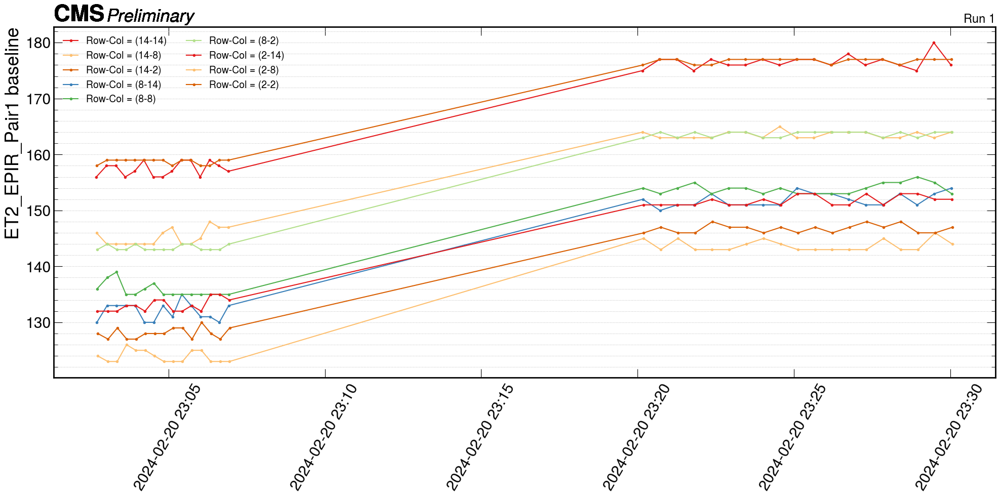

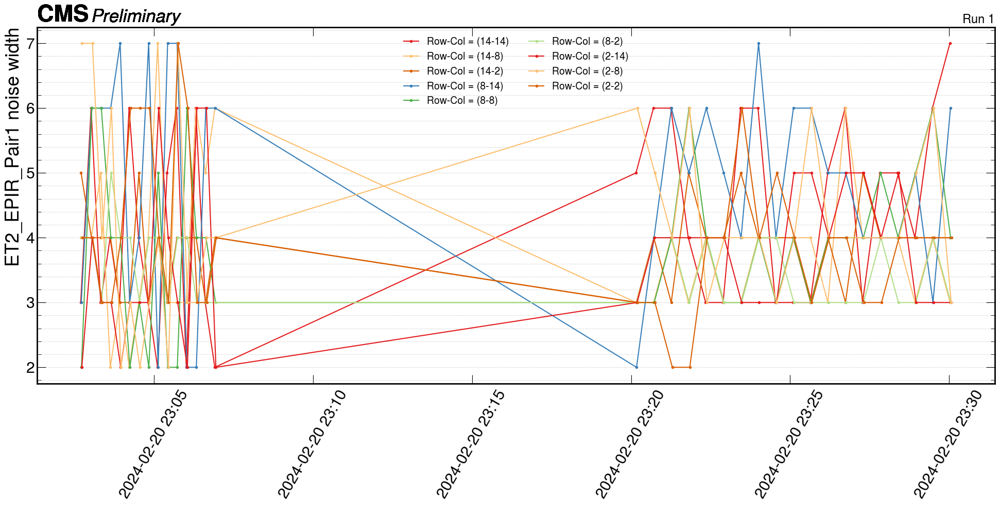

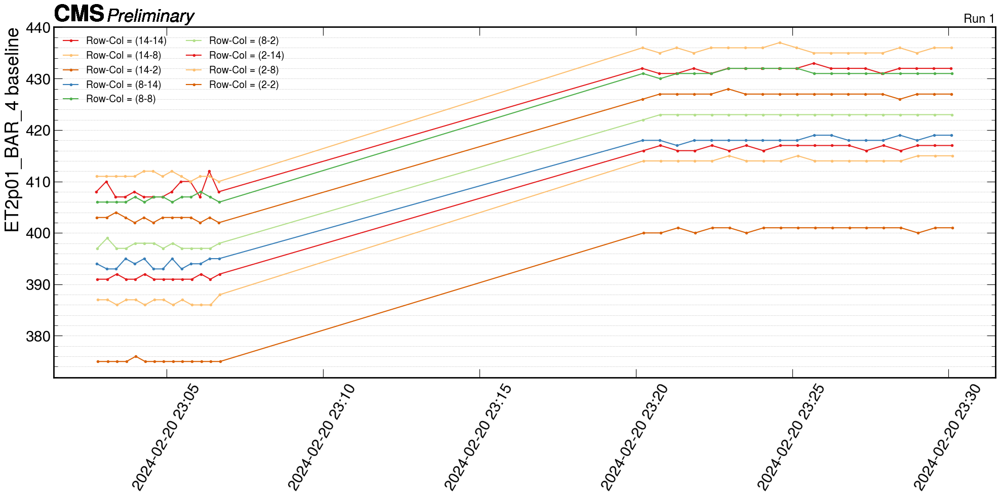

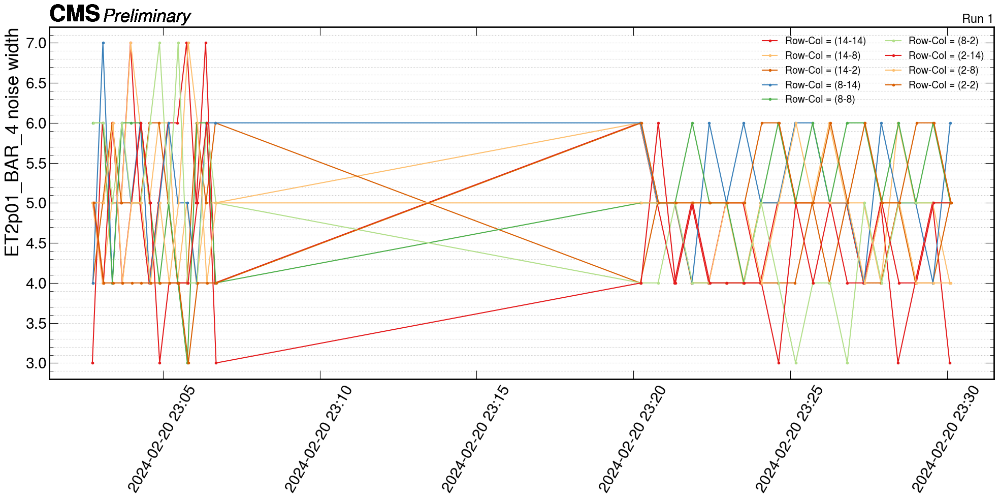

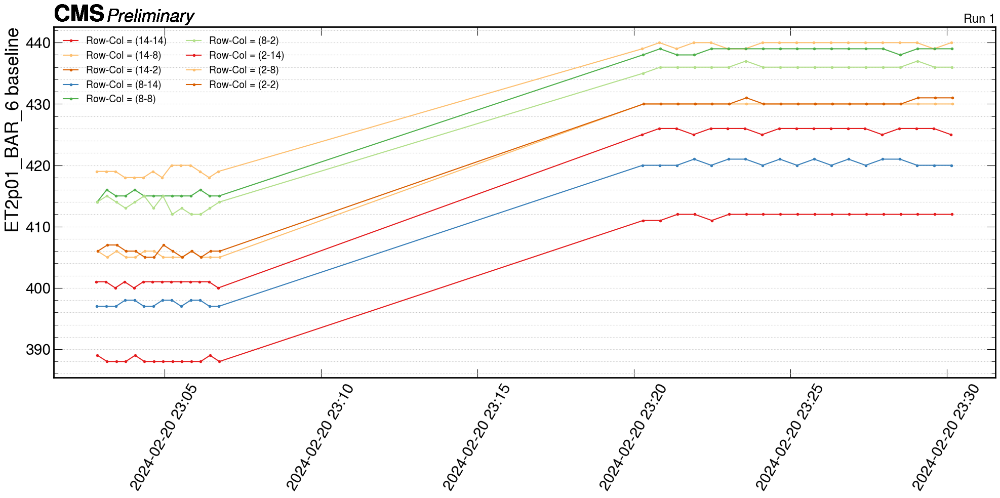

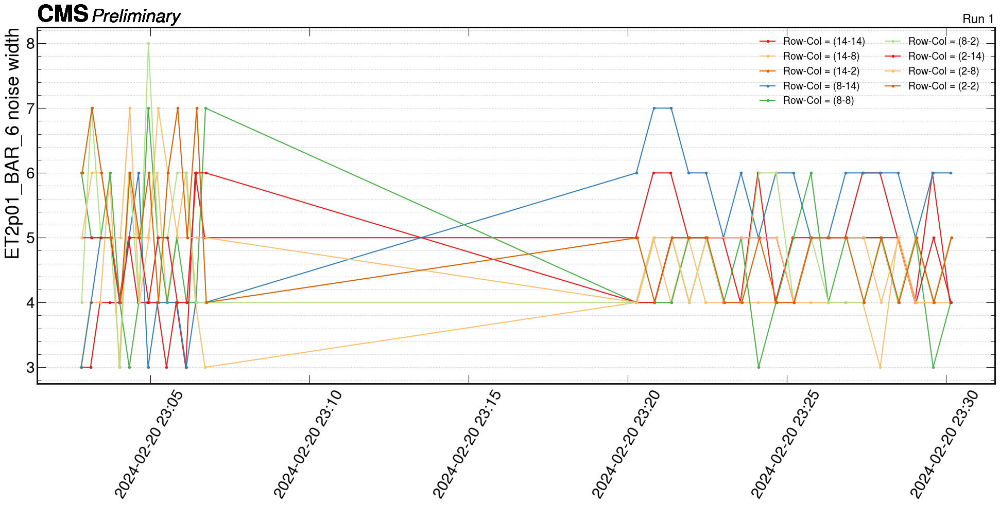

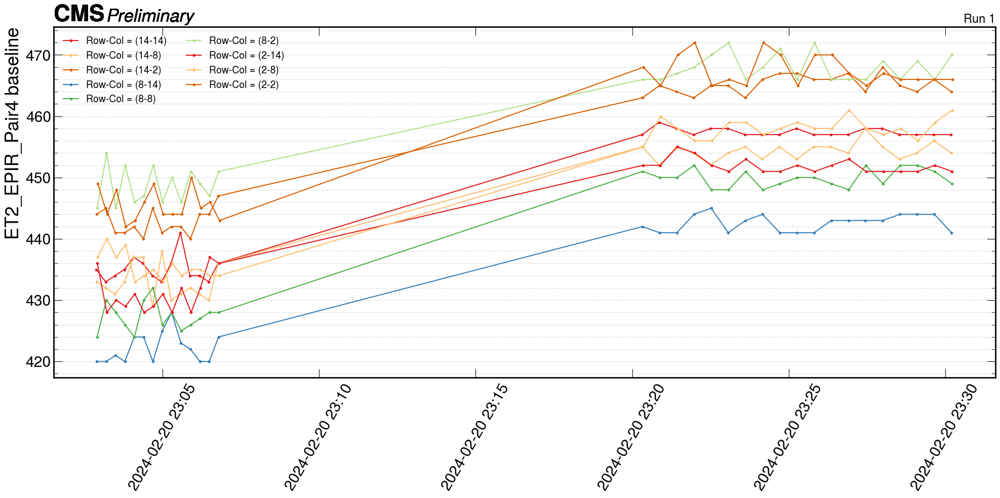

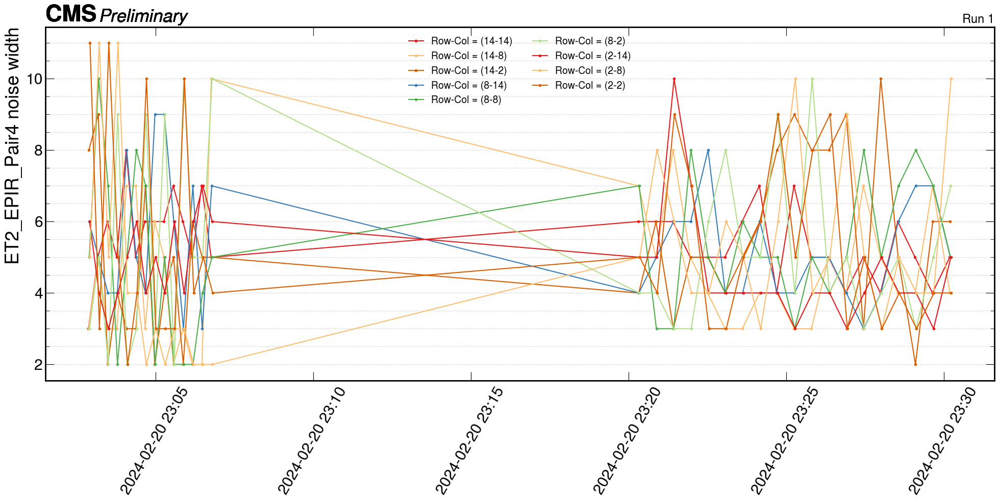

In [15]:
con = sqlite3.connect(histfile)
df = pd.read_sql_query("SELECT * from baselines", con)

time_cut = None # '2024-01-17 11:57:00'
note_cut = "PreBeam_BLmonitoring_withchiller12c" # First run with plastic and cooling at 12 C
label = 'Run 1'

for chip_name in chip_names:
    makePlot('baseline', chip_name, scan_list, time_cut, note_cut, label, df)
    makePlot('noise_width', chip_name, scan_list, time_cut, note_cut, label, df)

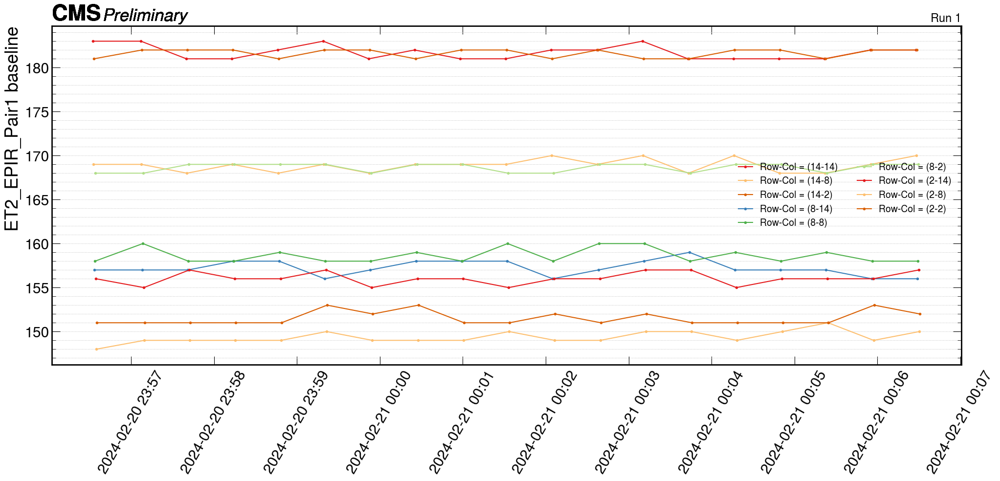

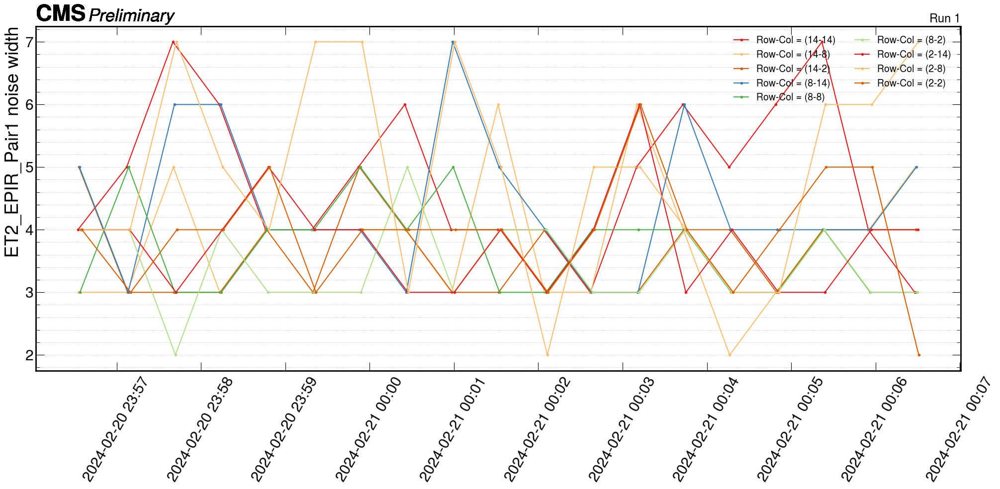

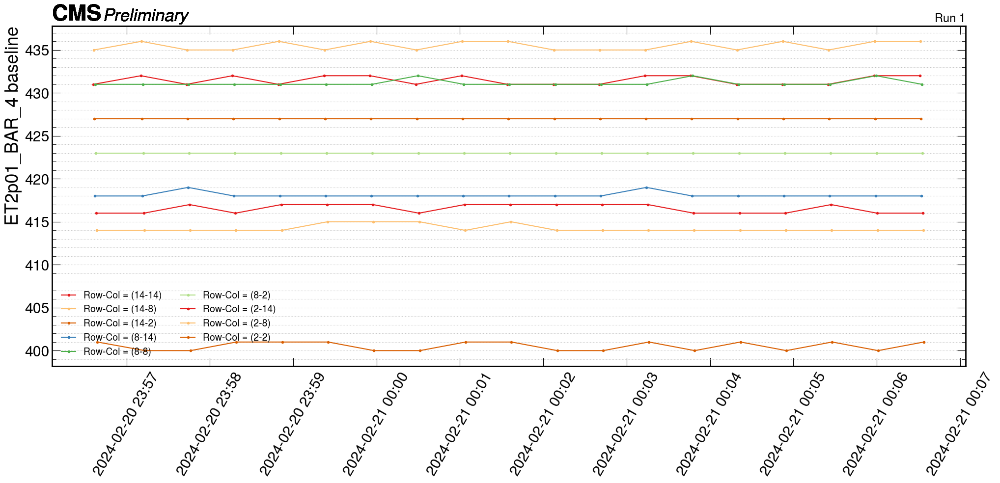

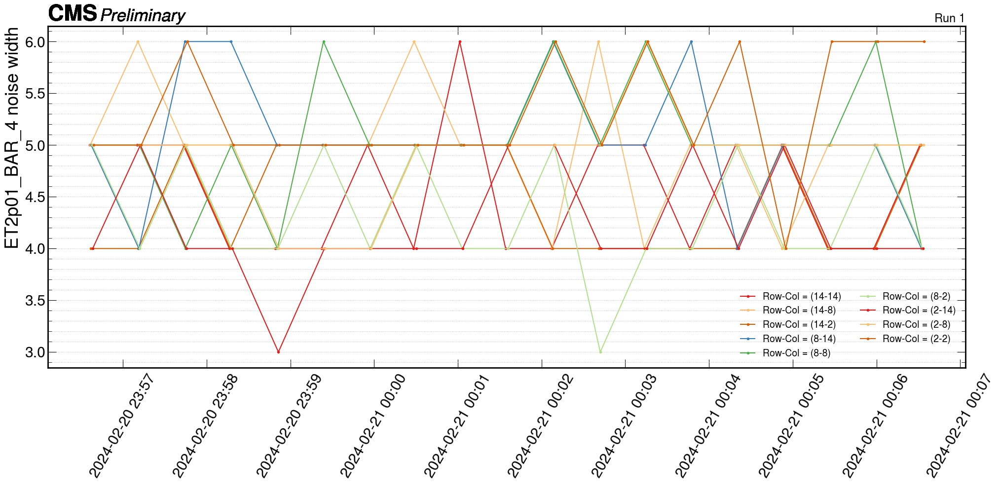

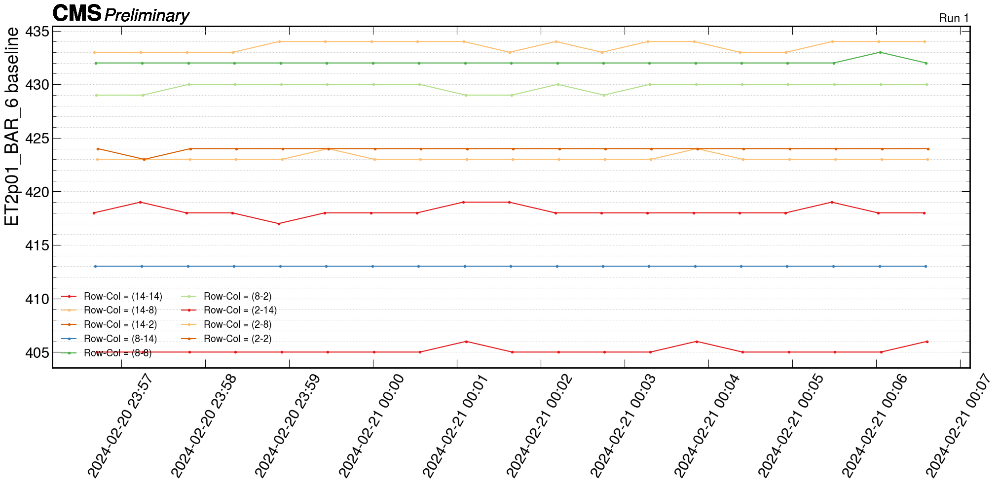

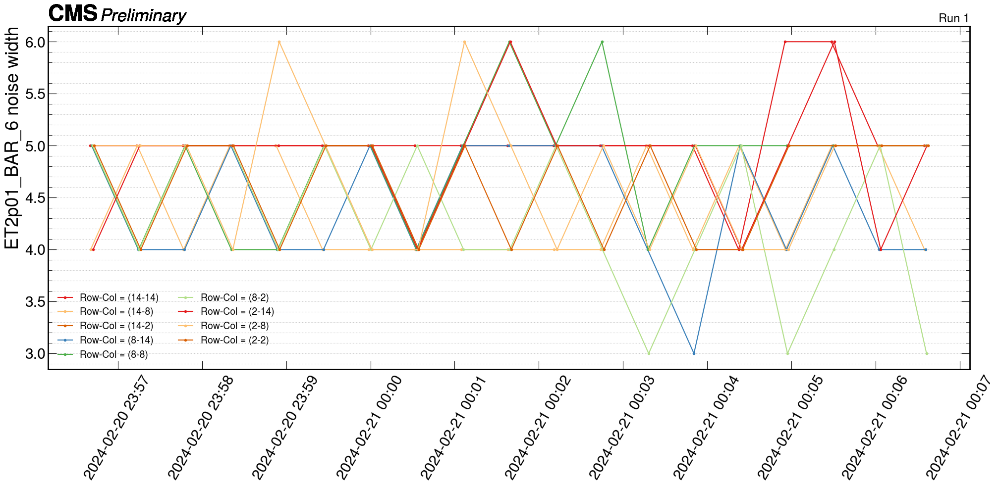

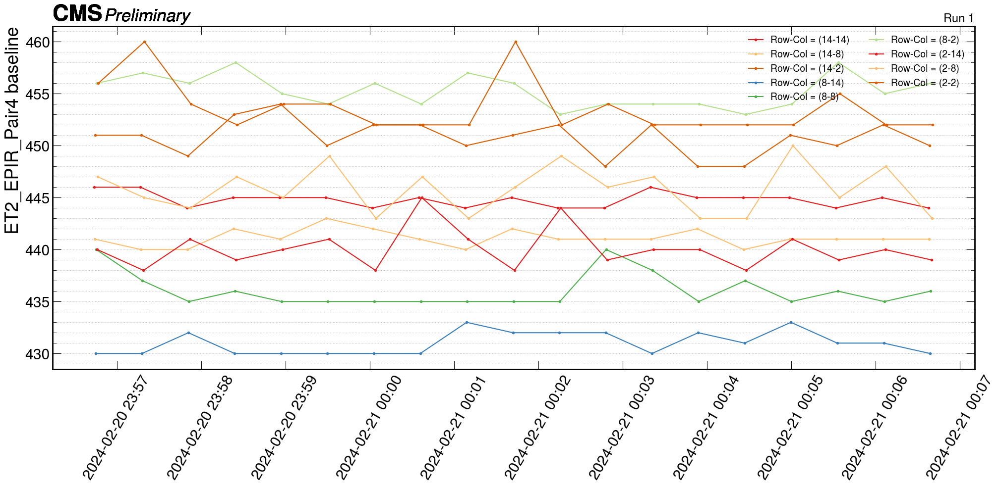

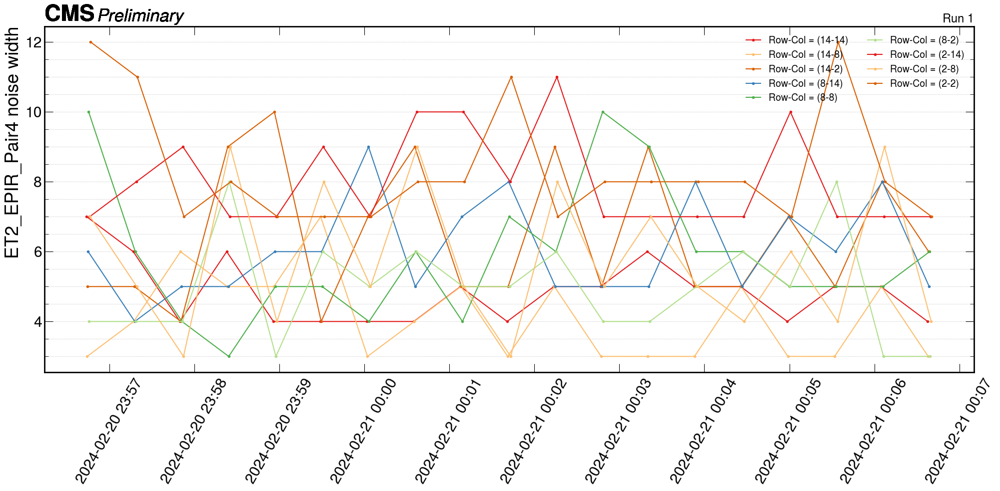

In [16]:
con = sqlite3.connect(histfile)
df = pd.read_sql_query("SELECT * from baselines", con)

time_cut = None # '2024-01-17 11:57:00'
note_cut = "PreBeam_BLmonitoring_withchiller12c_2" # Second run with plastic and cooling at 12 C with Pair 4 LV cables swaped to match the others
label = 'Run 1'

for chip_name in chip_names:
    makePlot('baseline', chip_name, scan_list, time_cut, note_cut, label, df)
    makePlot('noise_width', chip_name, scan_list, time_cut, note_cut, label, df)

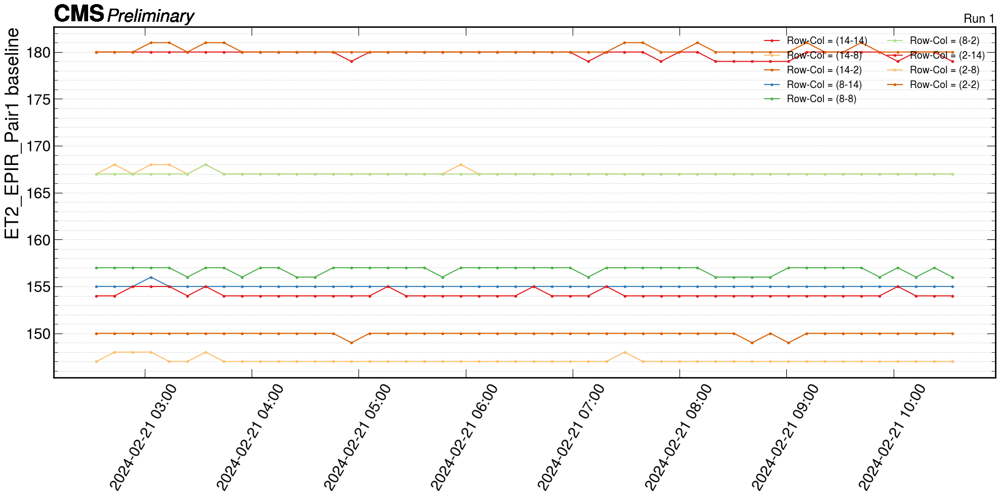

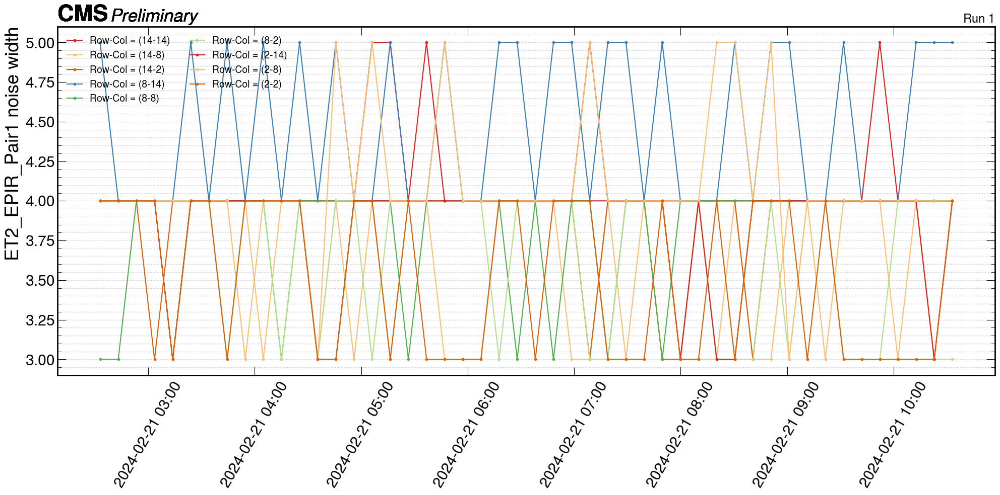

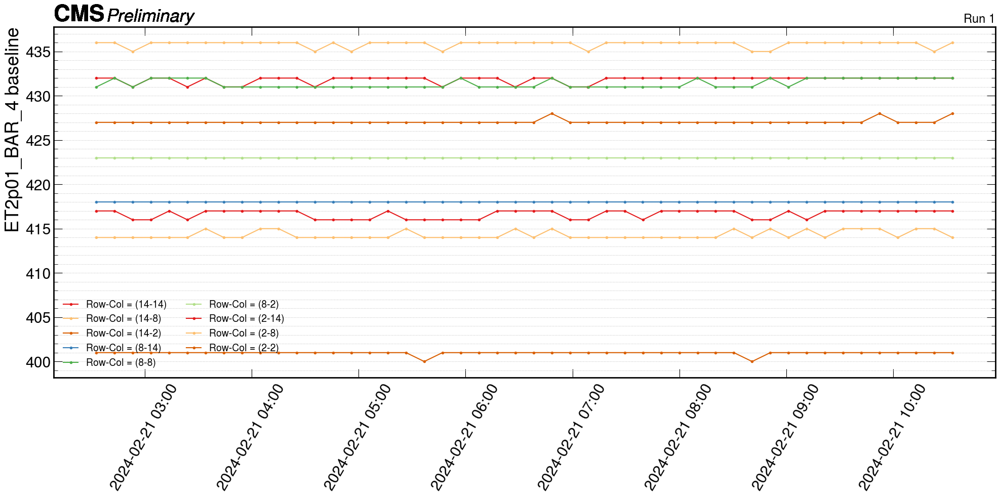

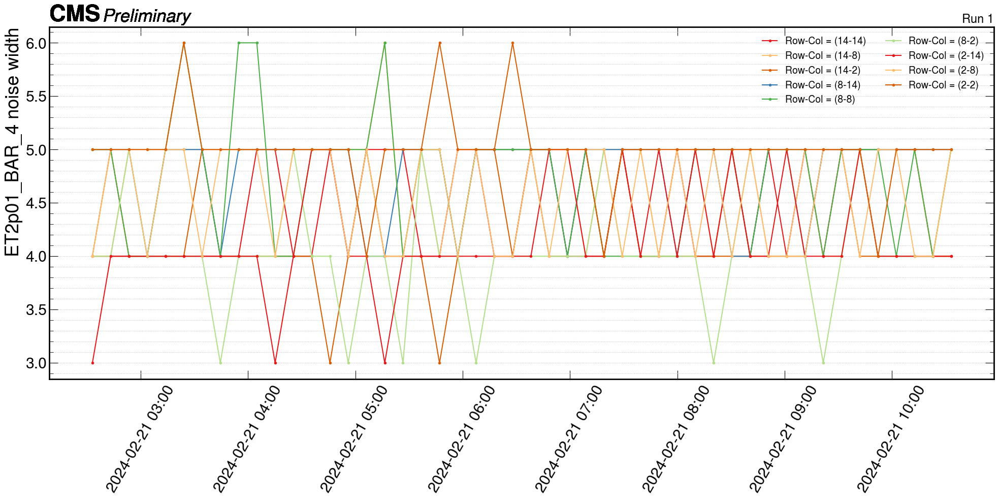

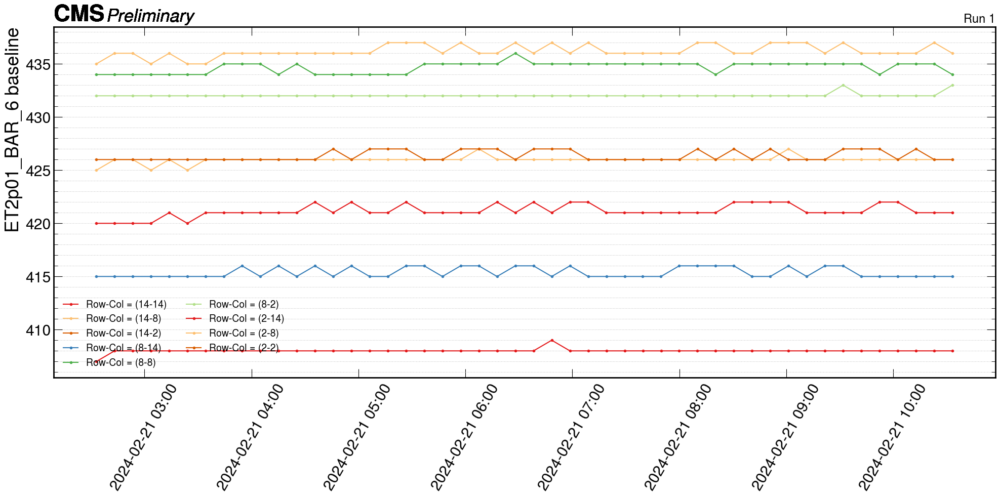

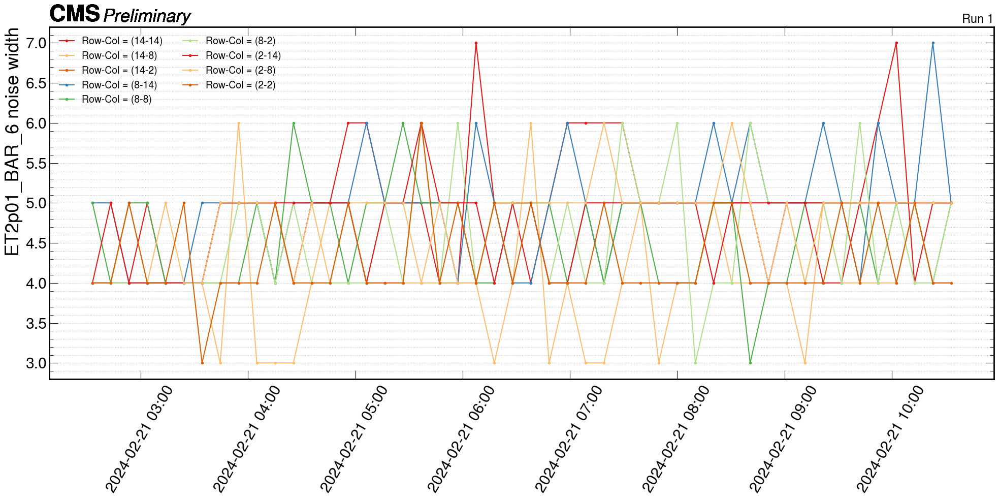

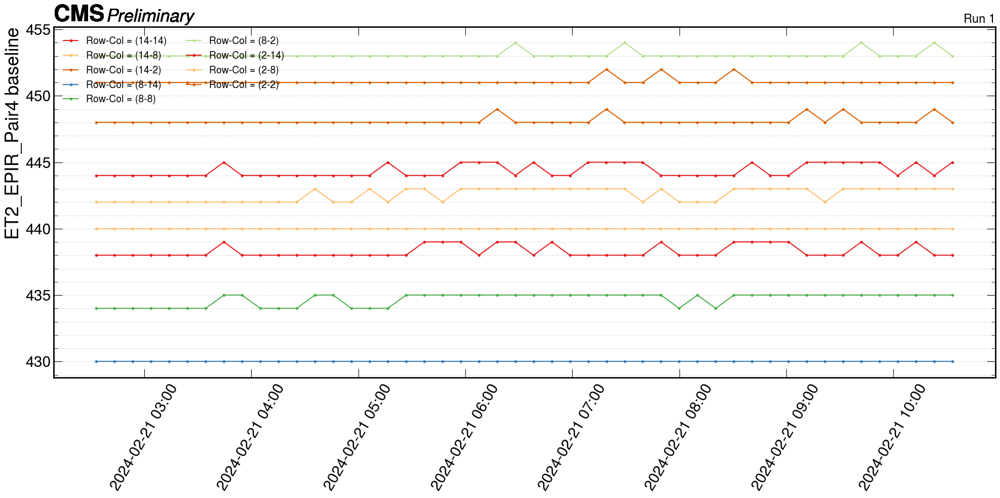

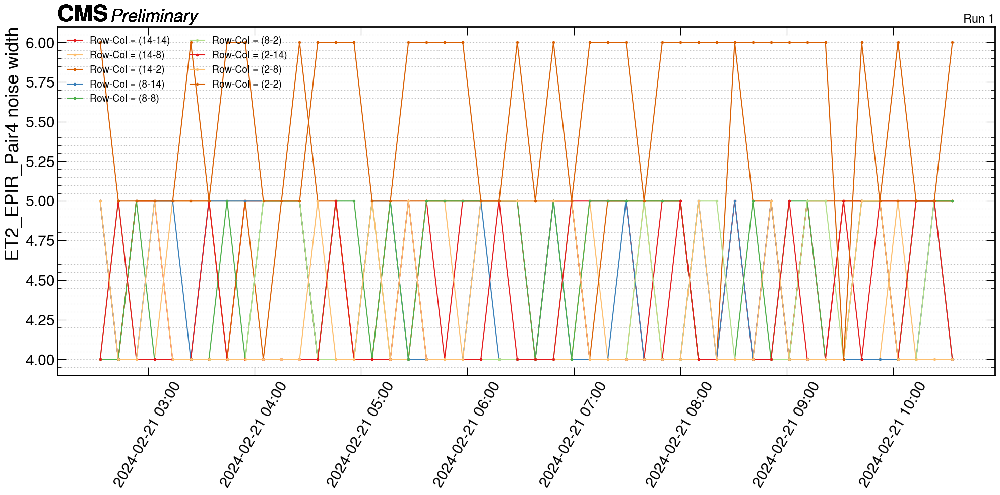

In [15]:
con = sqlite3.connect(histfile)
df = pd.read_sql_query("SELECT * from baselines", con)

time_cut = None # '2024-01-17 11:57:00'
note_cut = "PreBeam_BLmonitoring_withchiller12c_ONR" # Feb 20 ONR run with plastic and cooling at 12 C with HV @250 for all except Bar6 (HV off)
label = 'Run 1'

for chip_name in chip_names:
    makePlot('baseline', chip_name, scan_list, time_cut, note_cut, label, df)
    makePlot('noise_width', chip_name, scan_list, time_cut, note_cut, label, df)

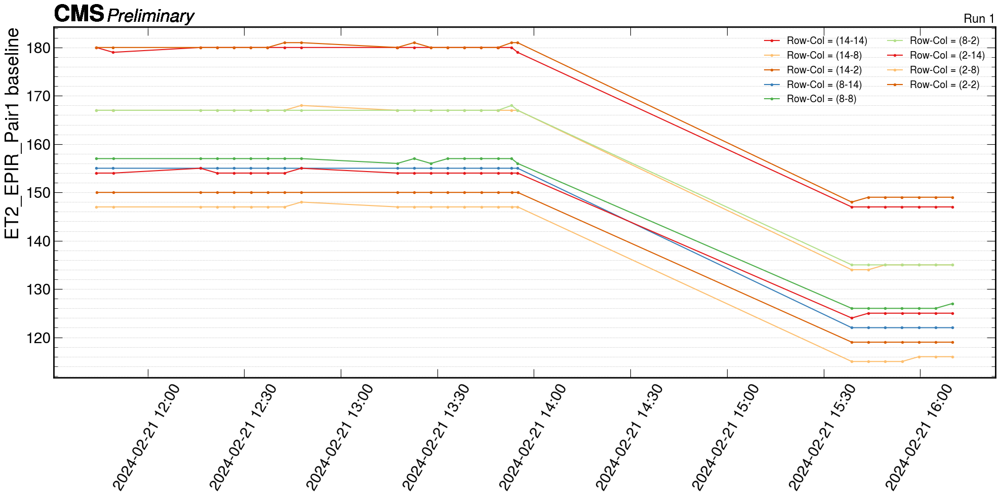

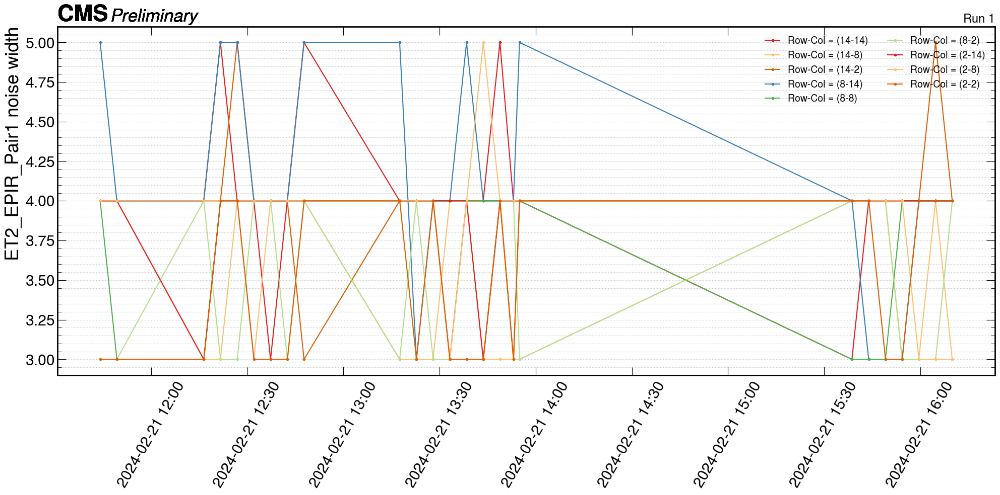

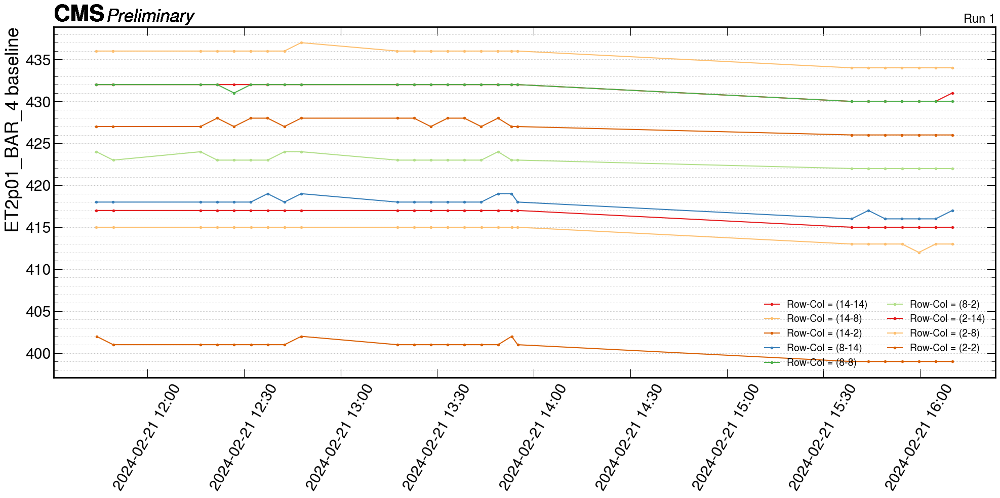

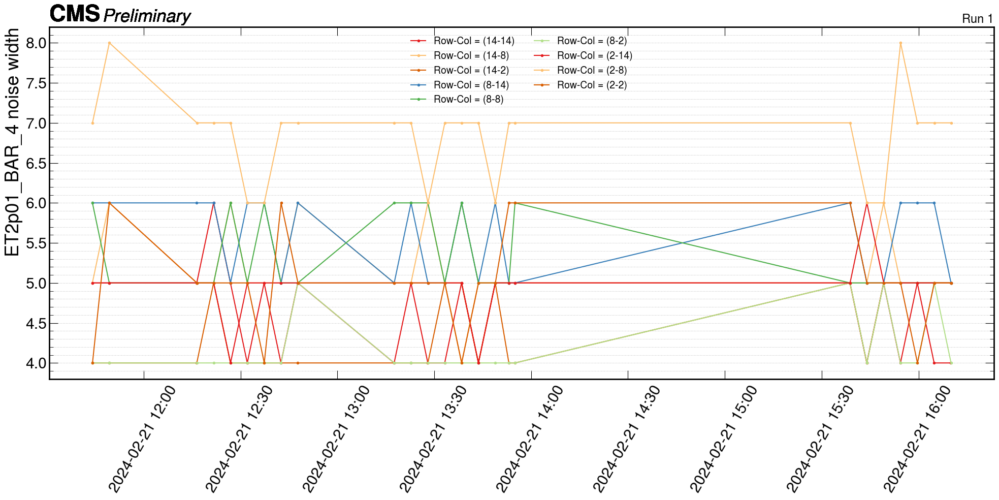

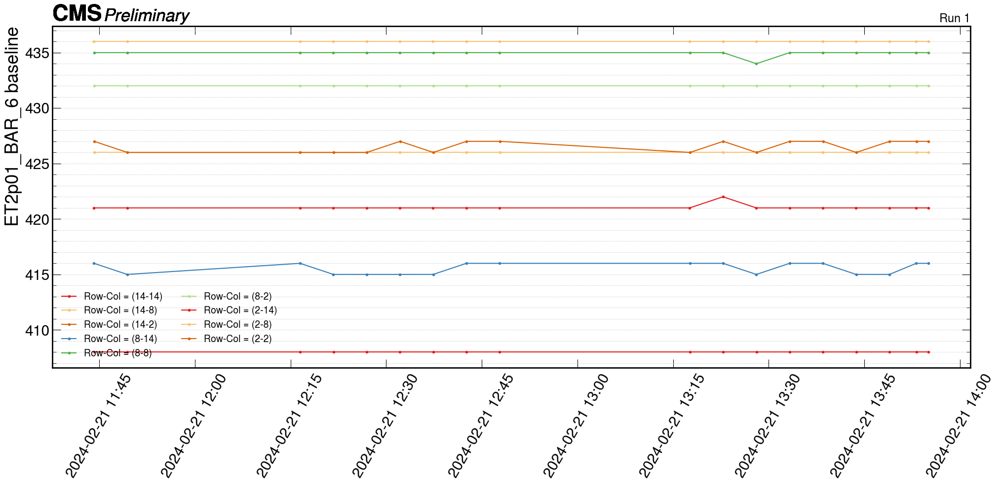

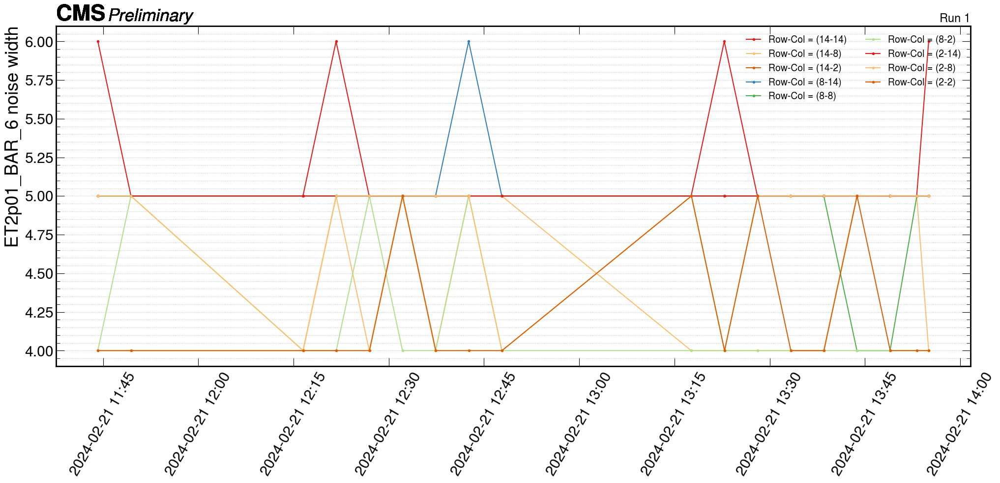

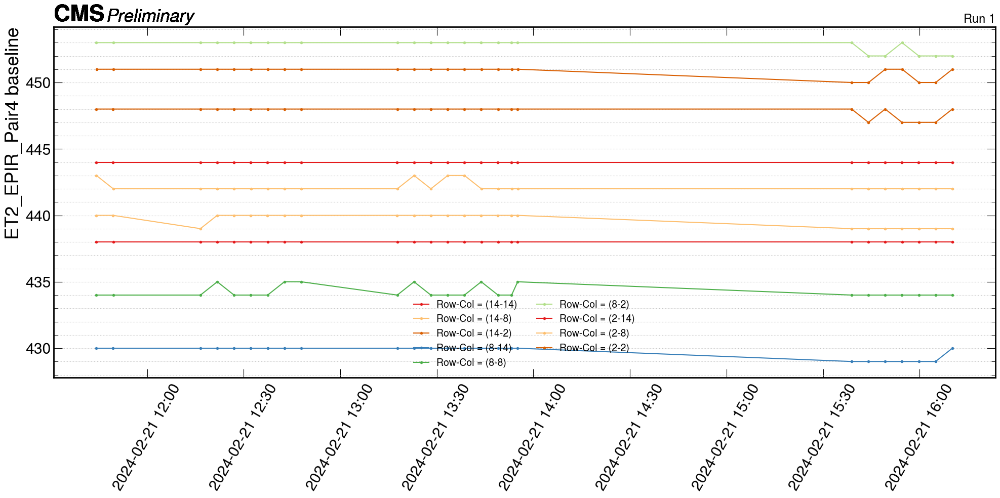

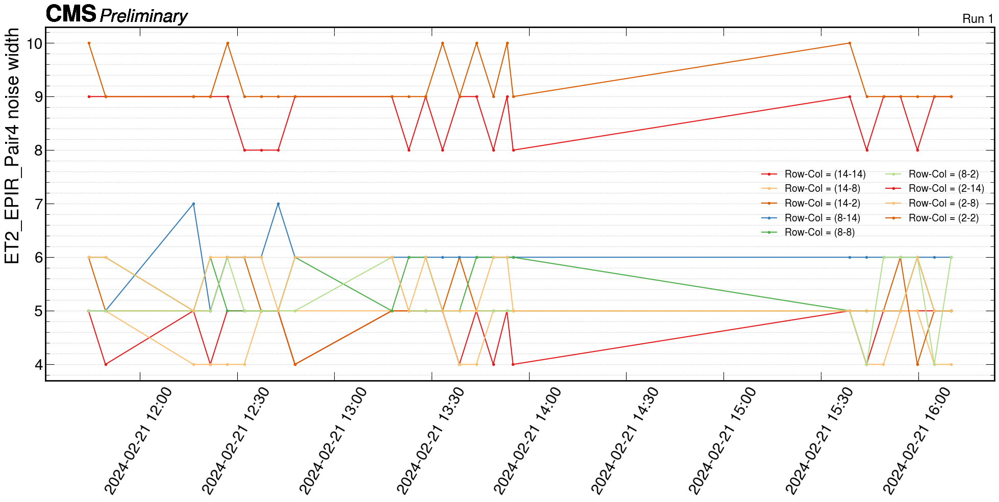

In [18]:
chip_names = ["ET2_EPIR_Pair1", "ET2p01_BAR_4", "ET2p01_BAR_6", "ET2_EPIR_Pair4"]
chip_fignames = ["ET2 EPIR Pair 1", "ET2.01 Barcelona 4", "ET2.01 Barcelona 6", "ET2 EPIR Pair4"]
chip_figtitles = chip_names

con = sqlite3.connect(histfile)
df = pd.read_sql_query("SELECT * from baselines", con)

time_cut = None # '2024-01-17 11:57:00'
note_cut = "PreBeam_BLmonitoring_withchiller12c_30mins" # Feb 21 30mins runs with HV 250V for all except Bar6 (HV off)
label = 'Run 1'

for chip_name in chip_names:
    makePlot('baseline', chip_name, scan_list, time_cut, note_cut, label, df)
    makePlot('noise_width', chip_name, scan_list, time_cut, note_cut, label, df)

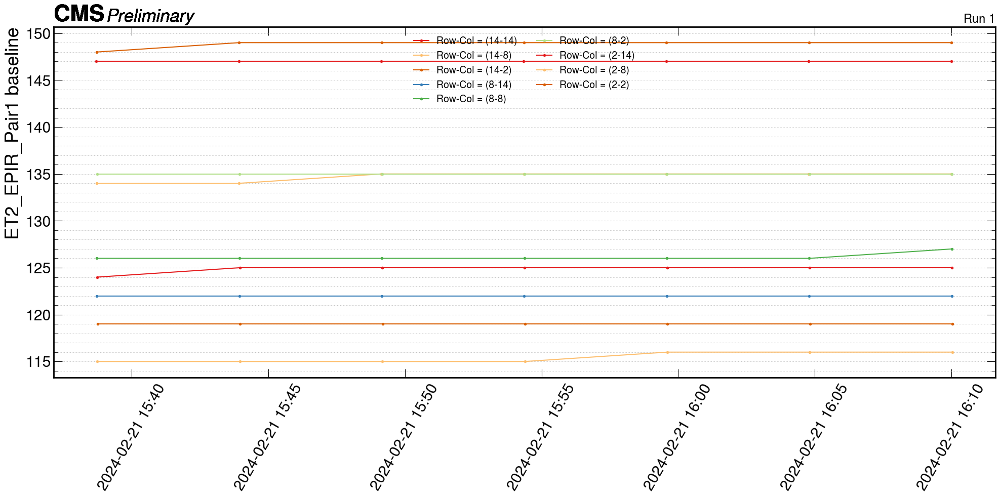

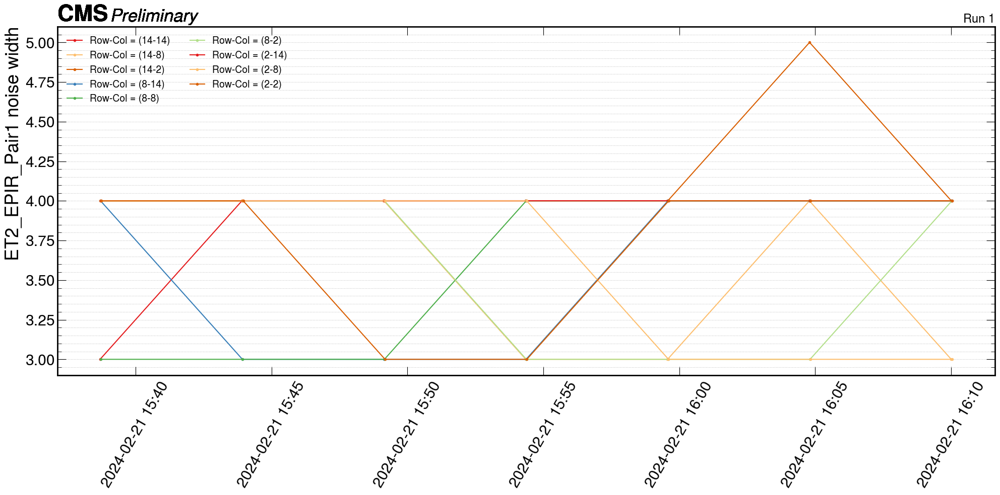

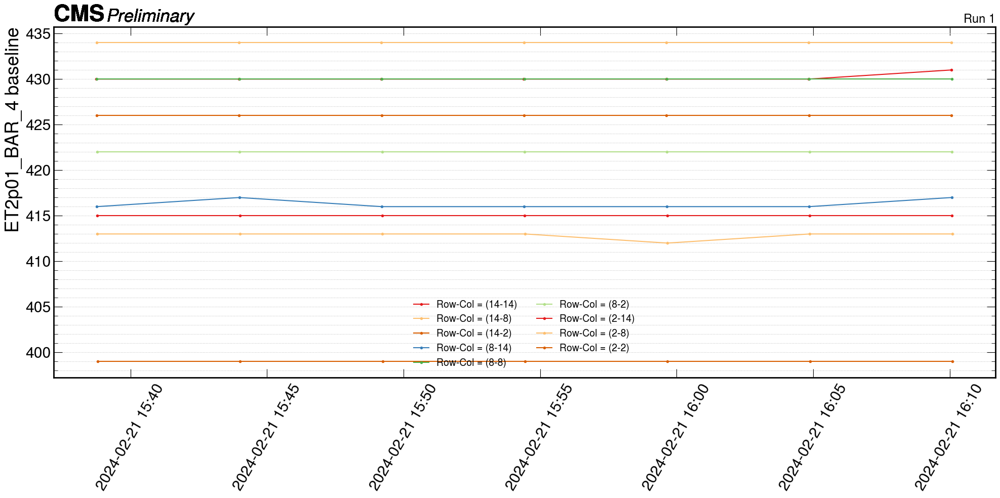

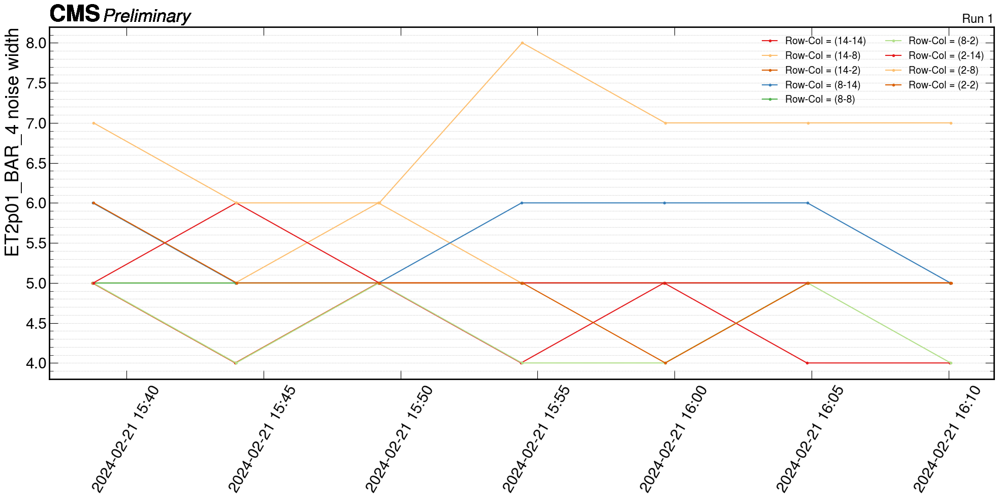

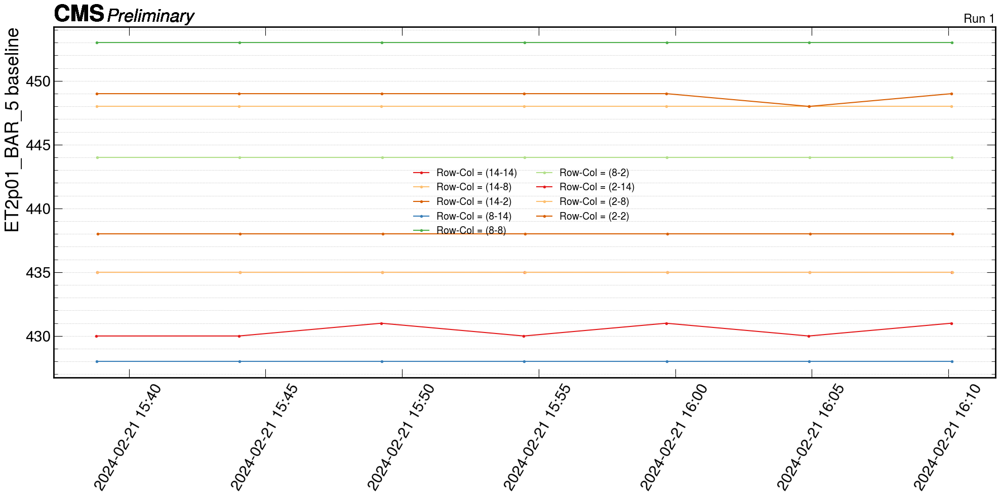

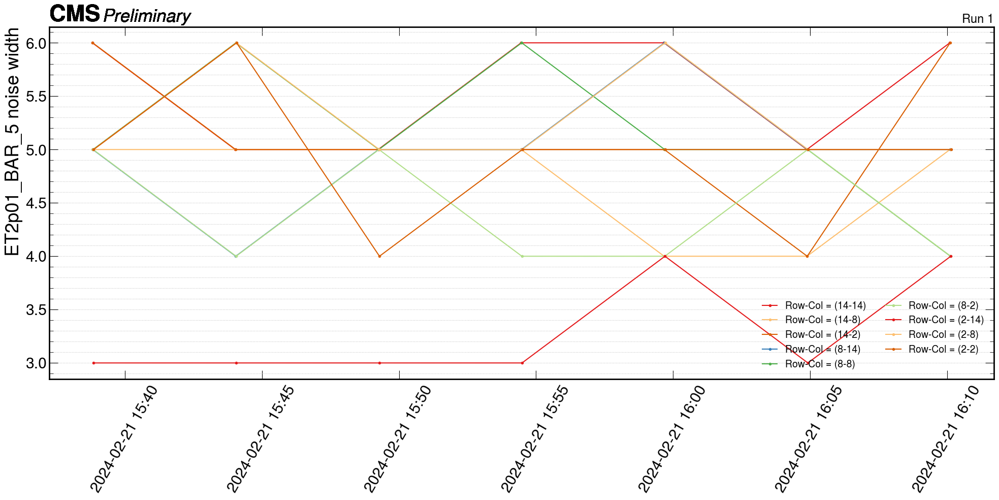

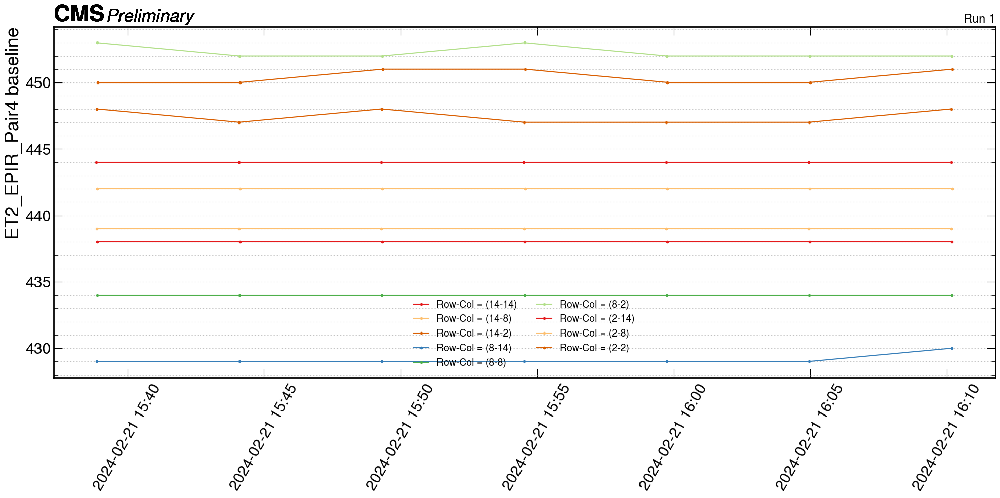

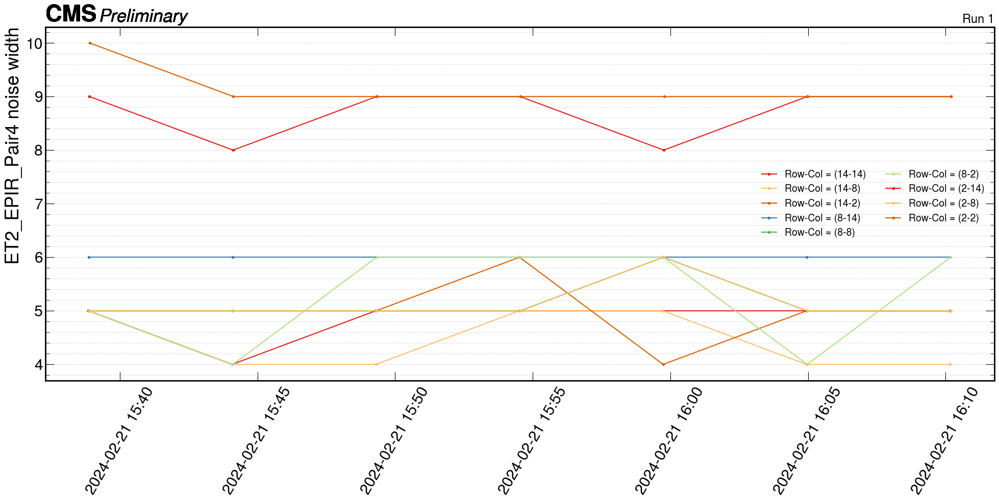

In [20]:
con = sqlite3.connect(histfile)
df = pd.read_sql_query("SELECT * from baselines", con)

time_cut = None # '2024-01-17 11:57:00'
note_cut = "PreBeam_BLmonitoring_withchiller12c_30mins_bar5" # Feb 21 first run with noplastic and cooling at 12 C with HV @250V for all except Bar5 (HV @210V)
label = 'Run 1'

for chip_name in chip_names:
    makePlot('baseline', chip_name, scan_list, time_cut, note_cut, label, df)
    makePlot('noise_width', chip_name, scan_list, time_cut, note_cut, label, df)

# Calibrate FC and PLL for all I2C

In [10]:
for chip_address in chip_addresses[:]:
    i2c_conn.asyResetGlobalReadout(chip_address, chip=None)
    i2c_conn.asyAlignFastcommand(chip_address, chip=None)
    time.sleep(1)
    i2c_conn.calibratePLL(chip_address, chip=None)
    time.sleep(1)
    i2c_conn.asyResetGlobalReadout(chip_address, chip=None)
    i2c_conn.asyAlignFastcommand(chip_address, chip=None)

Reset Global Readout done for chip: 0x60
asyAlignFastcommand action done for chip: 0x60
PLL Calibrated for chip: 0x60
Reset Global Readout done for chip: 0x60
asyAlignFastcommand action done for chip: 0x60
Reset Global Readout done for chip: 0x61
asyAlignFastcommand action done for chip: 0x61
PLL Calibrated for chip: 0x61
Reset Global Readout done for chip: 0x61
asyAlignFastcommand action done for chip: 0x61
Reset Global Readout done for chip: 0x62
asyAlignFastcommand action done for chip: 0x62
PLL Calibrated for chip: 0x62
Reset Global Readout done for chip: 0x62
asyAlignFastcommand action done for chip: 0x62
Reset Global Readout done for chip: 0x63
asyAlignFastcommand action done for chip: 0x63
PLL Calibrated for chip: 0x63
Reset Global Readout done for chip: 0x63
asyAlignFastcommand action done for chip: 0x63


# Manual Noise

In [ ]:
i2c_conn.config_chips('00001000')

## Scan

In [ ]:
trigger_bit_noisescan(i2c_conn, chip_addresses[0], chip_names[0], LED_page, delay, active_channel, polarity, scan_list, verbose=False, pedestal_scan_step=1, attempt='_quietCB', busyCB=False, today=today, hostname=hostname)

## Plot

In [ ]:
trigger_bit_noisescan_plot(i2c_conn, chip_addresses[0], chip_figtitles[0], chip_names[0], scan_list, attempt='_quietCB', tag=" Quiet CB", autoBL=True, gaus=True, today=today)

# Disconnect I2C Device

In [ ]:
del i2c_conn